In [4]:
# %%
# %% [markdown]
# ## 1. Chargement des Bibliothèques
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, callbacks
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import cv2
import os
import pandas as pd
from sklearn.model_selection import StratifiedKFold
from tqdm import tqdm
from IPython.display import display
from math import ceil

# Reproductibilité
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)


In [5]:
# %%
# %% [markdown]
# ## 2. Paramètres et Configuration
IMG_SIZE = (256, 256) 
BATCH_SIZE = 16  # Augmenté pour mieux exploiter les nouvelles données
EPOCHS = 100
VAL_SPLIT = 0.15
TEST_SPLIT = 0.15
DATA_PATH = '/home/kevin/datasets/livrable2/processed_dataaug'
METADATA_PATH = os.path.join(DATA_PATH, 'metadata.csv')

NOISE_CONFIG = {
    'gaussian': {
        'mean': 0.08,      # Variance moyenne typique
        'std': 0.03,       # Écart-type pour la variance
        'clip': (0, 0.3)   # Plage de valeurs valides
    },
    'salt_pepper': {
        'mean': 0.04,      # Densité moyenne typique
        'std': 0.015,
        'clip': (0, 0.2)
    },
    'poisson': {},         # Bruit inhérent au capteur
    'speckle': {
        'mean': 0.12,
        'std': 0.05,
        'clip': (0, 0.4)
    }
}

In [6]:
# %%
# %% [markdown]
# ## 3. Chargement des Données avec Métadonnées (Nouvelle Version)

def data_generator(image_paths, clean_paths, batch_size=32):
    while True:
        indices = np.random.permutation(len(image_paths))
        for i in range(0, len(indices), batch_size):
            batch_paths = indices[i:i+batch_size]
            noisy_batch = []
            clean_batch = []
            for idx in batch_paths:
                # Chargement, forçage couleur et resize
                noisy = cv2.imread(image_paths[idx])
                noisy = cv2.cvtColor(noisy, cv2.COLOR_BGR2RGB) if noisy is not None else None
            
                clean = cv2.imread(clean_paths[idx])
                clean = cv2.cvtColor(clean, cv2.COLOR_BGR2RGB) if clean is not None else None
                
                if noisy is None:
                    noisy = np.zeros((*IMG_SIZE, 3), dtype=np.float32)
                else:
                    noisy = cv2.resize(noisy, IMG_SIZE)
                    noisy = noisy / 255.0
                if clean is None:
                    clean = np.zeros((*IMG_SIZE, 3), dtype=np.float32)
                else:
                    clean = cv2.resize(clean, IMG_SIZE)
                    clean = clean / 255.0
                # Augmentation aléatoire
                if np.random.rand() > 0.5:
                    noisy = cv2.flip(noisy, 1)
                    clean = cv2.flip(clean, 1)
                if np.random.rand() > 0.5:
                    angle = np.random.randint(-15, 15)
                    M = cv2.getRotationMatrix2D((IMG_SIZE[0]//2, IMG_SIZE[1]//2), angle, 1)
                    noisy = cv2.warpAffine(noisy, M, IMG_SIZE)
                    clean = cv2.warpAffine(clean, M, IMG_SIZE)
                noisy_batch.append(noisy)
                clean_batch.append(clean)
            yield np.stack(noisy_batch), np.stack(clean_batch)

def prepare_generators(data_path, metadata_path, test_size=0.2, val_size=0.2, batch_size=32):
    # Charger les métadonnées
    metadata = pd.read_csv(metadata_path)
    
    # Créer les listes de chemins complets
    image_paths = [os.path.join(data_path, 'noisy', f) for f in metadata['noisy']]
    clean_paths = [os.path.join(data_path, 'clean', f) for f in metadata['original']]
    
    # Split initial train/test
    train_paths, test_paths, train_clean, test_clean = train_test_split(
        image_paths, clean_paths, 
        test_size=test_size, 
        random_state=SEED
    )
    
    # Split train/val
    train_paths, val_paths, train_clean, val_clean = train_test_split(
        train_paths, train_clean,
        test_size=val_size,
        random_state=SEED
    )
    
    return {
        'train': data_generator(train_paths, train_clean, BATCH_SIZE),
        'val': data_generator(val_paths, val_clean, BATCH_SIZE),
        'test': (
            np.array([
                cv2.resize(cv2.imread(p, cv2.IMREAD_COLOR), IMG_SIZE)/255.0
                if cv2.imread(p, cv2.IMREAD_COLOR) is not None else np.zeros((*IMG_SIZE, 3))
                for p in test_paths
            ]),
            np.array([
                cv2.resize(cv2.imread(p, cv2.IMREAD_COLOR), IMG_SIZE)/255.0
                if cv2.imread(p, cv2.IMREAD_COLOR) is not None else np.zeros((*IMG_SIZE, 3))
                for p in test_clean
            ])
        ),
        'steps': {
            'train': len(train_paths) // BATCH_SIZE,
            'val': len(val_paths) // BATCH_SIZE
        }
    }

# Chargement avec métadonnées
try:
    data = prepare_generators(DATA_PATH, METADATA_PATH, test_size=TEST_SPLIT, val_size=VAL_SPLIT, batch_size=BATCH_SIZE)
except Exception as e:
    print(f"Erreur: {e}")
    raise

# Accès aux données
train_gen = data['train']
val_gen = data['val']
(X_noisy, X_clean) = data['test']
steps = data['steps']


In [7]:
# %%
# %% [markdown]
# ## 4. Data Augmentation en Temps Réel

# data_augmentation = tf.keras.Sequential([
#     layers.RandomFlip("horizontal_and_vertical"),
#     layers.RandomRotation(0.2),
#     layers.RandomZoom(0.1),
#     layers.RandomContrast(0.1)
# ])

# def preprocess_data(image, label):
#     # Application de l'augmentation seulement sur l'image d'entrée
#     augmented_image = data_augmentation(image)
#     return augmented_image, label

# # Création des datasets avec augmentation
# train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
# train_dataset = train_dataset.shuffle(buffer_size=1024, reshuffle_each_iteration=True)
# train_dataset = train_dataset.map(preprocess_data, num_parallel_calls=tf.data.AUTOTUNE)
# train_dataset = train_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

# val_dataset = tf.data.Dataset.from_tensor_slices((X_val, y_val))
# val_dataset = val_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

In [8]:
# %%
# %% [markdown]
# ## 5. Architecture du Modèle (Améliorée)

class SpatialAttention(layers.Layer):
    def __init__(self, ratio=8, **kwargs):
        super().__init__(**kwargs)
        self.ratio = ratio
        self.dense1 = layers.Dense(1, activation='sigmoid')

    def build(self, input_shape):
        self.conv = layers.Conv2D(1, 7, padding='same', activation='sigmoid')
        super().build(input_shape)

    def call(self, x):
        # Attention spatiale
        max_pool = tf.reduce_max(x, axis=-1, keepdims=True)
        avg_pool = tf.reduce_mean(x, axis=-1, keepdims=True)
        concat = layers.Concatenate()([max_pool, avg_pool])
        attention = self.conv(concat)
        return x * attention

def residual_block(x, filters, use_attention=False):
    # Project shortcut if input channels do not match output filters
    shortcut = x
    if x.shape[-1] != filters:
        shortcut = layers.Conv2D(filters, 1, padding='same')(shortcut)
    x = layers.Conv2D(filters, 3, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(filters, 3, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    if use_attention:
        x = SpatialAttention()(x)
    
    x = layers.Add()([shortcut, x])
    return layers.Activation('relu')(x)

def multi_scale_unet(input_shape=(256,256,3)):
    inputs = layers.Input(input_shape)
    
    # Encoder multi-échelle
    e1 = residual_block(inputs, 64)
    p1 = layers.MaxPooling2D()(e1)
    
    e2 = residual_block(p1, 128, use_attention=True)
    p2 = layers.MaxPooling2D()(e2)
    
    e3 = residual_block(p2, 256, use_attention=True)
    p3 = layers.MaxPooling2D()(e3)
    
    # Bridge
    bridge = residual_block(p3, 512, use_attention=True)
    bridge = layers.Dropout(0.4)(bridge)
    
    # Decoder avec connexions denses
    d3 = layers.UpSampling2D()(bridge)
    d3 = layers.Concatenate()([d3, e3])
    d3 = residual_block(d3, 256)
    
    d2 = layers.UpSampling2D()(d3)
    d2 = layers.Concatenate()([d2, e2])
    d2 = residual_block(d2, 128)
    
    d1 = layers.UpSampling2D()(d2)
    d1 = layers.Concatenate()([d1, e1])
    d1 = residual_block(d1, 64)
    
    outputs = layers.Conv2D(3, 1, activation='sigmoid')(d1)
    
    return Model(inputs, outputs)

In [9]:
# 1. Définition des métriques de base
def PSNR(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

def SSIM(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

# 2. Métrique hybride personnalisée
class HybridPSNRSSIM(tf.keras.metrics.Metric):
    def __init__(self, name='hybrid_psnr_ssim', **kwargs):
        super().__init__(name=name, **kwargs)
        self.psnr = tf.keras.metrics.Mean(name='psnr')
        self.ssim = tf.keras.metrics.Mean(name='ssim')
        
    def update_state(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, tf.float32)
        y_pred = tf.cast(y_pred, tf.float32)
        self.psnr.update_state(tf.image.psnr(y_true, y_pred, 1.0))
        self.ssim.update_state(tf.image.ssim(y_true, y_pred, 1.0))
        
    def result(self):
        return (self.psnr.result() + self.ssim.result())/2
    
    def reset_states(self):
        self.psnr.reset_states()
        self.ssim.reset_states()

# 3. Perte hybride avancée avec intégration VGG
# Initialisation du modèle VGG16 (à placer avant la fonction de perte)
vgg = tf.keras.applications.VGG16(
    include_top=False,
    weights='imagenet',
    input_shape=(256, 256, 3)
)
vgg.trainable = False

def hybrid_loss(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    # Calcul des différentes composantes de la perte
    ssim_loss = 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))
    mse_loss = tf.reduce_mean(tf.square(y_true - y_pred))

    # Pré-traitement pour VGG16 (mise à l'échelle [0,255])
    y_true_scaled = y_true * 255.0
    y_pred_scaled = y_pred * 255.0

    # Extraction des caractéristiques
    y_true_features = vgg(tf.keras.applications.vgg16.preprocess_input(y_true_scaled))
    y_pred_features = vgg(tf.keras.applications.vgg16.preprocess_input(y_pred_scaled))

    # Perte perceptuelle
    perceptual_loss = tf.reduce_mean(tf.square(y_true_features - y_pred_features))

    # Combinaison pondérée
    return 0.6 * ssim_loss + 0.3 * mse_loss + 0.1 * perceptual_loss

I0000 00:00:1744961142.765041     702 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 21770 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:2b:00.0, compute capability: 8.6


In [ ]:
# %%
# %% [markdown]
# ## 6. Stratégie d'Entraînement Avancée

class NoiseAdaptiveLoss(tf.keras.losses.Loss):
    def __init__(self, noise_info, **kwargs):
        super().__init__(**kwargs)
        self.noise_levels = np.array([info[1] or 0 for info in noise_info])
        self.loss_fn = tf.keras.losses.MeanSquaredError(reduction=tf.keras.losses.Reduction.NONE)
        
    def __call__(self, y_true, y_pred, sample_weight=None):
        loss = self.loss_fn(y_true, y_pred)
        # Pondération en fonction du niveau de bruit
        weighted_loss = loss * (1 + tf.cast(self.noise_levels, tf.float32))
        return tf.reduce_mean(weighted_loss)
    
# Callback personnalisé pour le monitoring des métriques par type de bruit
class NoiseTypeMonitor(callbacks.Callback):
    def __init__(self, X_val, y_val, noise_info):
        super().__init__()
        self.X_val = X_val
        self.y_val = y_val
        self.noise_info = noise_info

    def on_epoch_end(self, epoch, logs=None):
        # Évaluation par type de bruit
        for noise_type in NOISE_CONFIG.keys():
            idx = [i for i, info in enumerate(self.noise_info) if info[0] == noise_type]
            if len(idx) > 0:
                X_sub = self.X_val[idx]
                y_sub = self.y_val[idx]
                results = self.model.evaluate(X_sub, y_sub, verbose=0)
                logs[f'val_{noise_type}_loss'] = results[0]
                logs[f'val_{noise_type}_psnr'] = results[1]
                logs[f'val_{noise_type}_ssim'] = results[2]

# Charger les métadonnées
metadata = pd.read_csv(METADATA_PATH)

# Récupérer les chemins de validation
val_indices = list(range(steps['train'] * BATCH_SIZE, (steps['train'] + steps['val']) * BATCH_SIZE))
val_metadata = metadata.iloc[val_indices]

# Générer X_val, y_val et noise_info
X_val = []
y_val = []
noise_info = []
for _, row in val_metadata.iterrows():
    noisy_path = os.path.join(DATA_PATH, 'noisy', row['noisy'])
    clean_path = os.path.join(DATA_PATH, 'clean', row['original'])
    noisy_img = cv2.imread(noisy_path, cv2.IMREAD_COLOR)
    noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB) if noisy_img is not None else None  
    clean_img = cv2.imread(clean_path, cv2.IMREAD_COLOR)
    clean_img = cv2.cvtColor(clean_img, cv2.COLOR_BGR2RGB) if clean_img is not None else None
    if noisy_img is not None and clean_img is not None:
        noisy_img = cv2.resize(noisy_img, IMG_SIZE) / 255.0
        clean_img = cv2.resize(clean_img, IMG_SIZE) / 255.0
        X_val.append(noisy_img)
        y_val.append(clean_img)
        # Suppose que le type de bruit et le niveau sont dans les colonnes 'noise_type' et 'noise_level'
        noise_info.append((row.get('noise_type', 'unknown'), row.get('noise_level', 0)))
X_val = np.array(X_val)
y_val = np.array(y_val)

# Optimiseur avec gradient clipping
# Optimiseur avec gradient clipping
optimizer = tf.keras.optimizers.AdamW(
    learning_rate=1e-3,
    weight_decay=1e-4,
    global_clipnorm=1.0
)

# Compilation
model = multi_scale_unet(input_shape=(256, 256, 3))
model.compile(
    optimizer=optimizer,
    loss=hybrid_loss,  # Utilisation de la perte hybride
    metrics=[
        PSNR,          # Métrique PSNR standard
        SSIM,          # Métrique SSIM standard
        HybridPSNRSSIM() # Métrique hybride personnalisée
    ]
)
# Définition des callbacks
early_stop = callbacks.EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)
checkpoint = callbacks.ModelCheckpoint(
    "notebooks/livrable2/models/best_model-v3-dataaug.h5",
    monitor="val_loss",
    save_best_only=True,
    verbose=1
)
tensorboard = callbacks.TensorBoard(
    log_dir="logs/fit/" + pd.Timestamp.now().strftime("%Y%m%d-%H%M%S"),
    histogram_freq=1
)


In [ ]:

# Entraînement du modèle
history = model.fit(
    train_gen,
    steps_per_epoch=steps['train'],
    validation_data=val_gen,
    validation_steps=steps['val'],
    epochs=EPOCHS,
    callbacks=[early_stop, checkpoint, tensorboard, NoiseTypeMonitor(X_val, y_val, noise_info)],
    verbose=1
)

Epoch 1/100


I0000 00:00:1744818765.945755    2673 service.cc:152] XLA service 0x7f30040039a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1744818765.945800    2673 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 3090, Compute Capability 8.6
2025-04-16 17:52:46.280425: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-04-16 17:52:46.909615: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert/Assert
2025-04-16 17:52:46.910494: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_1/Assert
2025-04-16 17:52:46.911202: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_2/Assert
2025-04-16 17:52:46.911668: W tensorflow/compiler/tf2xla/k

106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step - hybrid_psnr_ssim: 9.0486 - loss: 7.2746 - psnr: 17.6090 - ssim: 0.4882

2025-04-16 17:54:02.347855: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert/Assert
2025-04-16 17:54:02.349129: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_1/Assert
2025-04-16 17:54:02.350086: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_2/Assert
2025-04-16 17:54:02.350671: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_3/Assert



Epoch 1: val_loss improved from inf to 8.57630, saving model to models/best_model-v3-dataaug.h5


2025-04-16 17:54:09.359743: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 566231040 exceeds 10% of free system memory.


106/106 ━━━━━━━━━━━━━━━━━━━━ 143s 857ms/step - hybrid_psnr_ssim: 9.0677 - loss: 7.2542 - psnr: 17.6458 - ssim: 0.4896 - val_hybrid_psnr_ssim: 6.8450 - val_loss: 8.5763 - val_psnr: 13.2114 - val_ssim: 0.4786 - val_gaussian_loss: 10.7134 - val_gaussian_psnr: 13.4003 - val_gaussian_ssim: 0.4416 - val_salt_pepper_loss: 10.0287 - val_salt_pepper_psnr: 13.5824 - val_salt_pepper_ssim: 0.4647 - val_poisson_loss: 9.2668 - val_poisson_psnr: 13.7426 - val_poisson_ssim: 0.4846 - val_speckle_loss: 9.3720 - val_speckle_psnr: 13.7206 - val_speckle_ssim: 0.4802
Epoch 2/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step - hybrid_psnr_ssim: 12.5695 - loss: 3.6553 - psnr: 24.4050 - ssim: 0.7339
Epoch 2: val_loss improved from 8.57630 to 7.64022, saving model to models/best_model-v3-dataaug.h5


2025-04-16 17:56:23.256425: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 566231040 exceeds 10% of free system memory.


106/106 ━━━━━━━━━━━━━━━━━━━━ 88s 374ms/step - hybrid_psnr_ssim: 12.5708 - loss: 3.6530 - psnr: 24.4075 - ssim: 0.7341 - val_hybrid_psnr_ssim: 7.3344 - val_loss: 7.6402 - val_psnr: 14.1445 - val_ssim: 0.5243 - val_gaussian_loss: 9.8742 - val_gaussian_psnr: 14.2156 - val_gaussian_ssim: 0.4718 - val_salt_pepper_loss: 8.7310 - val_salt_pepper_psnr: 14.5330 - val_salt_pepper_ssim: 0.5161 - val_poisson_loss: 7.5113 - val_poisson_psnr: 14.8204 - val_poisson_ssim: 0.5611 - val_speckle_loss: 7.6705 - val_speckle_psnr: 14.7832 - val_speckle_ssim: 0.5513
Epoch 3/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 12.7520 - loss: 3.1627 - psnr: 24.7407 - ssim: 0.7632
Epoch 3: val_loss improved from 7.64022 to 5.96996, saving model to models/best_model-v3-dataaug.h5


2025-04-16 17:57:03.140510: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 566231040 exceeds 10% of free system memory.


106/106 ━━━━━━━━━━━━━━━━━━━━ 42s 398ms/step - hybrid_psnr_ssim: 12.7529 - loss: 3.1616 - psnr: 24.7425 - ssim: 0.7633 - val_hybrid_psnr_ssim: 8.5561 - val_loss: 5.9700 - val_psnr: 16.4916 - val_ssim: 0.6206 - val_gaussian_loss: 8.7749 - val_gaussian_psnr: 16.0525 - val_gaussian_ssim: 0.5308 - val_salt_pepper_loss: 6.8781 - val_salt_pepper_psnr: 16.6049 - val_salt_pepper_ssim: 0.6122 - val_poisson_loss: 5.1168 - val_poisson_psnr: 17.0476 - val_poisson_ssim: 0.6914 - val_speckle_loss: 5.3909 - val_speckle_psnr: 16.9853 - val_speckle_ssim: 0.6728
Epoch 4/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 12.9634 - loss: 2.9305 - psnr: 25.1484 - ssim: 0.7783
Epoch 4: val_loss improved from 5.96996 to 4.59578, saving model to models/best_model-v3-dataaug.h5


2025-04-16 17:57:41.679931: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 566231040 exceeds 10% of free system memory.


106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 353ms/step - hybrid_psnr_ssim: 12.9644 - loss: 2.9297 - psnr: 25.1505 - ssim: 0.7783 - val_hybrid_psnr_ssim: 10.2993 - val_loss: 4.5958 - val_psnr: 19.8903 - val_ssim: 0.7083 - val_gaussian_loss: 7.5293 - val_gaussian_psnr: 19.1840 - val_gaussian_ssim: 0.6000 - val_salt_pepper_loss: 4.8544 - val_salt_pepper_psnr: 20.3736 - val_salt_pepper_ssim: 0.7166 - val_poisson_loss: 2.7606 - val_poisson_psnr: 21.1315 - val_poisson_ssim: 0.8229 - val_speckle_loss: 3.1751 - val_speckle_psnr: 20.9508 - val_speckle_ssim: 0.7907
Epoch 5/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step - hybrid_psnr_ssim: 13.3108 - loss: 2.6978 - psnr: 25.8274 - ssim: 0.7941
Epoch 5: val_loss improved from 4.59578 to 3.38100, saving model to models/best_model-v3-dataaug.h5


2025-04-16 17:58:18.893170: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 566231040 exceeds 10% of free system memory.


106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 345ms/step - hybrid_psnr_ssim: 13.3107 - loss: 2.6975 - psnr: 25.8272 - ssim: 0.7941 - val_hybrid_psnr_ssim: 11.4203 - val_loss: 3.3810 - val_psnr: 22.0828 - val_ssim: 0.7578 - val_gaussian_loss: 6.5905 - val_gaussian_psnr: 20.3873 - val_gaussian_ssim: 0.6206 - val_salt_pepper_loss: 3.3856 - val_salt_pepper_psnr: 22.3059 - val_salt_pepper_ssim: 0.7718 - val_poisson_loss: 1.2899 - val_poisson_psnr: 23.3451 - val_poisson_ssim: 0.9027 - val_speckle_loss: 1.8276 - val_speckle_psnr: 23.0874 - val_speckle_ssim: 0.8564
Epoch 6/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 12.8976 - loss: 2.5828 - psnr: 25.0001 - ssim: 0.7951
Epoch 6: val_loss improved from 3.38100 to 2.89215, saving model to models/best_model-v3-dataaug.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 337ms/step - hybrid_psnr_ssim: 12.8995 - loss: 2.5828 - psnr: 25.0038 - ssim: 0.7951 - val_hybrid_psnr_ssim: 12.9425 - val_loss: 2.8921 - val_psnr: 25.0831 - val_ssim: 0.8019 - val_gaussian_loss: 6.1276 - val_gaussian_psnr: 22.4377 - val_gaussian_ssim: 0.6483 - val_salt_pepper_loss: 2.8088 - val_salt_pepper_psnr: 25.1338 - val_salt_pepper_ssim: 0.8097 - val_poisson_loss: 0.9030 - val_poisson_psnr: 26.9868 - val_poisson_ssim: 0.9321 - val_speckle_loss: 1.3435 - val_speckle_psnr: 26.5606 - val_speckle_ssim: 0.8923
Epoch 7/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 13.1728 - loss: 2.4324 - psnr: 25.5452 - ssim: 0.8004
Epoch 7: val_loss did not improve from 2.89215
106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 340ms/step - hybrid_psnr_ssim: 13.1744 - loss: 2.4326 - psnr: 25.5483 - ssim: 0.8004 - val_hybrid_psnr_ssim: 14.0411 - val_loss: 3.0081 - val_psnr: 27.3079 - val_ssim: 0.7742 - val_gaussian_loss: 6.0429 - val_gaussian_psnr: 23.4586 - val_ga

106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 350ms/step - hybrid_psnr_ssim: 13.3563 - loss: 2.4192 - psnr: 25.9056 - ssim: 0.8071 - val_hybrid_psnr_ssim: 14.2209 - val_loss: 2.6611 - val_psnr: 27.6353 - val_ssim: 0.8065 - val_gaussian_loss: 5.6747 - val_gaussian_psnr: 23.1216 - val_gaussian_ssim: 0.6468 - val_salt_pepper_loss: 2.1990 - val_salt_pepper_psnr: 27.2392 - val_salt_pepper_ssim: 0.8262 - val_poisson_loss: 0.4021 - val_poisson_psnr: 32.0904 - val_poisson_ssim: 0.9621 - val_speckle_loss: 1.0100 - val_speckle_psnr: 29.9797 - val_speckle_ssim: 0.9068
Epoch 10/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 13.4646 - loss: 2.2415 - psnr: 26.1137 - ssim: 0.8155
Epoch 10: val_loss did not improve from 2.66111
106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 349ms/step - hybrid_psnr_ssim: 13.4644 - loss: 2.2420 - psnr: 26.1134 - ssim: 0.8155 - val_hybrid_psnr_ssim: 14.5484 - val_loss: 2.7264 - val_psnr: 28.2861 - val_ssim: 0.8107 - val_gaussian_loss: 5.8740 - val_gaussian_psnr: 23.6412 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 39s 370ms/step - hybrid_psnr_ssim: 13.5165 - loss: 2.1351 - psnr: 26.2158 - ssim: 0.8173 - val_hybrid_psnr_ssim: 14.3591 - val_loss: 2.2574 - val_psnr: 27.8885 - val_ssim: 0.8296 - val_gaussian_loss: 5.3911 - val_gaussian_psnr: 23.4838 - val_gaussian_ssim: 0.6612 - val_salt_pepper_loss: 1.8192 - val_salt_pepper_psnr: 27.5729 - val_salt_pepper_ssim: 0.8438 - val_poisson_loss: 0.3374 - val_poisson_psnr: 32.0300 - val_poisson_ssim: 0.9670 - val_speckle_loss: 0.8913 - val_speckle_psnr: 29.9222 - val_speckle_ssim: 0.9095
Epoch 13/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step - hybrid_psnr_ssim: 13.7526 - loss: 2.1306 - psnr: 26.6824 - ssim: 0.8229
Epoch 13: val_loss did not improve from 2.25745
106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 349ms/step - hybrid_psnr_ssim: 13.7524 - loss: 2.1305 - psnr: 26.6820 - ssim: 0.8229 - val_hybrid_psnr_ssim: 14.1972 - val_loss: 2.4578 - val_psnr: 27.5794 - val_ssim: 0.8150 - val_gaussian_loss: 5.2663 - val_gaussian_psnr: 23.7932 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 342ms/step - hybrid_psnr_ssim: 13.9493 - loss: 1.9594 - psnr: 27.0714 - ssim: 0.8272 - val_hybrid_psnr_ssim: 14.3870 - val_loss: 2.2564 - val_psnr: 27.9491 - val_ssim: 0.8250 - val_gaussian_loss: 4.8713 - val_gaussian_psnr: 23.8107 - val_gaussian_ssim: 0.6594 - val_salt_pepper_loss: 1.5177 - val_salt_pepper_psnr: 27.6118 - val_salt_pepper_ssim: 0.8524 - val_poisson_loss: 0.3362 - val_poisson_psnr: 31.2230 - val_poisson_ssim: 0.9718 - val_speckle_loss: 0.8584 - val_speckle_psnr: 29.3034 - val_speckle_ssim: 0.9062
Epoch 21/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step - hybrid_psnr_ssim: 14.1164 - loss: 1.7790 - psnr: 27.3955 - ssim: 0.8373
Epoch 21: val_loss improved from 2.25643 to 2.05750, saving model to models/best_model-v3-dataaug.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 41s 385ms/step - hybrid_psnr_ssim: 14.1164 - loss: 1.7788 - psnr: 27.3956 - ssim: 0.8373 - val_hybrid_psnr_ssim: 14.9545 - val_loss: 2.0575 - val_psnr: 29.0624 - val_ssim: 0.8466 - val_gaussian_loss: 4.7535 - val_gaussian_psnr: 24.0325 - val_gaussian_ssim: 0.6888 - val_salt_pepper_loss: 1.6028 - val_salt_pepper_psnr: 28.3626 - val_salt_pepper_ssim: 0.8597 - val_poisson_loss: 0.3633 - val_poisson_psnr: 34.3588 - val_poisson_ssim: 0.9730 - val_speckle_loss: 0.9027 - val_speckle_psnr: 30.7433 - val_speckle_ssim: 0.9190
Epoch 22/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 13.8224 - loss: 1.8136 - psnr: 26.8116 - ssim: 0.8332
Epoch 22: val_loss did not improve from 2.05750
106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 353ms/step - hybrid_psnr_ssim: 13.8231 - loss: 1.8136 - psnr: 26.8129 - ssim: 0.8332 - val_hybrid_psnr_ssim: 14.6796 - val_loss: 2.4702 - val_psnr: 28.5214 - val_ssim: 0.8378 - val_gaussian_loss: 4.5880 - val_gaussian_psnr: 24.3340 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 38s 361ms/step - hybrid_psnr_ssim: 14.1499 - loss: 1.6741 - psnr: 27.4590 - ssim: 0.8407 - val_hybrid_psnr_ssim: 14.8178 - val_loss: 1.9295 - val_psnr: 28.7960 - val_ssim: 0.8397 - val_gaussian_loss: 4.4188 - val_gaussian_psnr: 23.7004 - val_gaussian_ssim: 0.6796 - val_salt_pepper_loss: 1.4582 - val_salt_pepper_psnr: 28.2587 - val_salt_pepper_ssim: 0.8623 - val_poisson_loss: 0.3048 - val_poisson_psnr: 34.0242 - val_poisson_ssim: 0.9730 - val_speckle_loss: 0.7989 - val_speckle_psnr: 30.3717 - val_speckle_ssim: 0.9155
Epoch 25/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step - hybrid_psnr_ssim: 13.7306 - loss: 1.7465 - psnr: 26.6297 - ssim: 0.8316
Epoch 25: val_loss did not improve from 1.92953
106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 348ms/step - hybrid_psnr_ssim: 13.7319 - loss: 1.7459 - psnr: 26.6321 - ssim: 0.8317 - val_hybrid_psnr_ssim: 14.8613 - val_loss: 2.1119 - val_psnr: 28.8793 - val_ssim: 0.8432 - val_gaussian_loss: 4.4476 - val_gaussian_psnr: 24.4066 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 348ms/step - hybrid_psnr_ssim: 14.1958 - loss: 1.5019 - psnr: 27.5451 - ssim: 0.8465 - val_hybrid_psnr_ssim: 14.8274 - val_loss: 1.7954 - val_psnr: 28.8095 - val_ssim: 0.8452 - val_gaussian_loss: 3.6629 - val_gaussian_psnr: 24.6526 - val_gaussian_ssim: 0.7070 - val_salt_pepper_loss: 1.2291 - val_salt_pepper_psnr: 28.9795 - val_salt_pepper_ssim: 0.8715 - val_poisson_loss: 0.4187 - val_poisson_psnr: 32.4637 - val_poisson_ssim: 0.9667 - val_speckle_loss: 0.7910 - val_speckle_psnr: 30.8494 - val_speckle_ssim: 0.9182
Epoch 33/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 14.2074 - loss: 1.4719 - psnr: 27.5666 - ssim: 0.8483
Epoch 33: val_loss did not improve from 1.79539
106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 340ms/step - hybrid_psnr_ssim: 14.2077 - loss: 1.4716 - psnr: 27.5671 - ssim: 0.8483 - val_hybrid_psnr_ssim: 15.1960 - val_loss: 1.9041 - val_psnr: 29.5441 - val_ssim: 0.8480 - val_gaussian_loss: 3.7610 - val_gaussian_psnr: 24.6103 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 339ms/step - hybrid_psnr_ssim: 14.2211 - loss: 1.4147 - psnr: 27.5910 - ssim: 0.8511 - val_hybrid_psnr_ssim: 14.9199 - val_loss: 1.7413 - val_psnr: 28.9889 - val_ssim: 0.8510 - val_gaussian_loss: 3.6297 - val_gaussian_psnr: 24.4631 - val_gaussian_ssim: 0.7092 - val_salt_pepper_loss: 1.1265 - val_salt_pepper_psnr: 28.8876 - val_salt_pepper_ssim: 0.8767 - val_poisson_loss: 0.2516 - val_poisson_psnr: 33.4378 - val_poisson_ssim: 0.9735 - val_speckle_loss: 0.6449 - val_speckle_psnr: 30.9513 - val_speckle_ssim: 0.9171
Epoch 36/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - hybrid_psnr_ssim: 14.4056 - loss: 1.3834 - psnr: 27.9566 - ssim: 0.8545
Epoch 36: val_loss did not improve from 1.74133
106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 337ms/step - hybrid_psnr_ssim: 14.4058 - loss: 1.3831 - psnr: 27.9572 - ssim: 0.8545 - val_hybrid_psnr_ssim: 14.6046 - val_loss: 1.8577 - val_psnr: 28.3459 - val_ssim: 0.8632 - val_gaussian_loss: 3.7718 - val_gaussian_psnr: 23.9980 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 49s 468ms/step - hybrid_psnr_ssim: 14.4237 - loss: 1.2961 - psnr: 27.9872 - ssim: 0.8601 - val_hybrid_psnr_ssim: 15.3328 - val_loss: 1.6920 - val_psnr: 29.8160 - val_ssim: 0.8496 - val_gaussian_loss: 3.4573 - val_gaussian_psnr: 24.8917 - val_gaussian_ssim: 0.7040 - val_salt_pepper_loss: 1.0100 - val_salt_pepper_psnr: 29.6552 - val_salt_pepper_ssim: 0.8805 - val_poisson_loss: 0.2169 - val_poisson_psnr: 34.9619 - val_poisson_ssim: 0.9759 - val_speckle_loss: 0.6198 - val_speckle_psnr: 31.7189 - val_speckle_ssim: 0.9203
Epoch 40/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - hybrid_psnr_ssim: 14.3609 - loss: 1.3292 - psnr: 27.8677 - ssim: 0.8542
Epoch 40: val_loss improved from 1.69203 to 1.65177, saving model to models/best_model-v3-dataaug.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 45s 430ms/step - hybrid_psnr_ssim: 14.3611 - loss: 1.3291 - psnr: 27.8679 - ssim: 0.8542 - val_hybrid_psnr_ssim: 15.3471 - val_loss: 1.6518 - val_psnr: 29.8366 - val_ssim: 0.8577 - val_gaussian_loss: 3.2800 - val_gaussian_psnr: 24.5907 - val_gaussian_ssim: 0.7047 - val_salt_pepper_loss: 0.9782 - val_salt_pepper_psnr: 29.5834 - val_salt_pepper_ssim: 0.8860 - val_poisson_loss: 0.1775 - val_poisson_psnr: 35.3033 - val_poisson_ssim: 0.9816 - val_speckle_loss: 0.5313 - val_speckle_psnr: 31.5920 - val_speckle_ssim: 0.9298
Epoch 41/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - hybrid_psnr_ssim: 14.2129 - loss: 1.2832 - psnr: 27.5709 - ssim: 0.8549
Epoch 41: val_loss did not improve from 1.65177
106/106 ━━━━━━━━━━━━━━━━━━━━ 36s 344ms/step - hybrid_psnr_ssim: 14.2144 - loss: 1.2832 - psnr: 27.5739 - ssim: 0.8549 - val_hybrid_psnr_ssim: 15.5276 - val_loss: 1.6538 - val_psnr: 30.2038 - val_ssim: 0.8514 - val_gaussian_loss: 3.3861 - val_gaussian_psnr: 24.6833 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 40s 379ms/step - hybrid_psnr_ssim: 14.5089 - loss: 1.2659 - psnr: 28.1586 - ssim: 0.8592 - val_hybrid_psnr_ssim: 15.4319 - val_loss: 1.5465 - val_psnr: 30.0029 - val_ssim: 0.8609 - val_gaussian_loss: 2.9863 - val_gaussian_psnr: 24.9631 - val_gaussian_ssim: 0.7153 - val_salt_pepper_loss: 0.9476 - val_salt_pepper_psnr: 30.0384 - val_salt_pepper_ssim: 0.8863 - val_poisson_loss: 0.2099 - val_poisson_psnr: 34.8986 - val_poisson_ssim: 0.9730 - val_speckle_loss: 0.5536 - val_speckle_psnr: 32.3012 - val_speckle_ssim: 0.9252
Epoch 44/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - hybrid_psnr_ssim: 14.6679 - loss: 1.2356 - psnr: 28.4731 - ssim: 0.8626
Epoch 44: val_loss improved from 1.54649 to 1.51892, saving model to models/best_model-v3-dataaug.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 350ms/step - hybrid_psnr_ssim: 14.6668 - loss: 1.2355 - psnr: 28.4709 - ssim: 0.8626 - val_hybrid_psnr_ssim: 15.1825 - val_loss: 1.5189 - val_psnr: 29.5059 - val_ssim: 0.8591 - val_gaussian_loss: 2.9637 - val_gaussian_psnr: 24.6790 - val_gaussian_ssim: 0.7193 - val_salt_pepper_loss: 0.8843 - val_salt_pepper_psnr: 29.6135 - val_salt_pepper_ssim: 0.8884 - val_poisson_loss: 0.1939 - val_poisson_psnr: 34.6405 - val_poisson_ssim: 0.9752 - val_speckle_loss: 0.5367 - val_speckle_psnr: 31.8100 - val_speckle_ssim: 0.9264
Epoch 45/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - hybrid_psnr_ssim: 14.4099 - loss: 1.2766 - psnr: 27.9641 - ssim: 0.8557
Epoch 45: val_loss did not improve from 1.51892
106/106 ━━━━━━━━━━━━━━━━━━━━ 37s 347ms/step - hybrid_psnr_ssim: 14.4099 - loss: 1.2765 - psnr: 27.9640 - ssim: 0.8557 - val_hybrid_psnr_ssim: 15.1278 - val_loss: 1.6306 - val_psnr: 29.4001 - val_ssim: 0.8555 - val_gaussian_loss: 3.1032 - val_gaussian_psnr: 24.7309 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 39s 366ms/step - hybrid_psnr_ssim: 14.6075 - loss: 1.1113 - psnr: 28.3478 - ssim: 0.8671 - val_hybrid_psnr_ssim: 15.1559 - val_loss: 1.3366 - val_psnr: 29.4478 - val_ssim: 0.8641 - val_gaussian_loss: 2.5854 - val_gaussian_psnr: 24.8714 - val_gaussian_ssim: 0.7249 - val_salt_pepper_loss: 0.7712 - val_salt_pepper_psnr: 29.7269 - val_salt_pepper_ssim: 0.8926 - val_poisson_loss: 0.1515 - val_poisson_psnr: 33.9055 - val_poisson_ssim: 0.9761 - val_speckle_loss: 0.4597 - val_speckle_psnr: 31.7820 - val_speckle_ssim: 0.9269
Epoch 52/100
Epoch 52/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - hybrid_psnr_ssim: 14.6786 - loss: 1.1723 - psnr: 28.4951 - ssim: 0.8621
Epoch 52: val_loss did not improve from 1.33658
106/106 ━━━━━━━━━━━━━━━━━━━━ 39s 371ms/step - hybrid_psnr_ssim: 14.6790 - loss: 1.1719 - psnr: 28.4959 - ssim: 0.8621 - val_hybrid_psnr_ssim: 15.4975 - val_loss: 1.5335 - val_psnr: 30.1305 - val_ssim: 0.8645 - val_gaussian_loss: 2.9329 - val_gaussian_psnr: 2

In [25]:
import glob

### LOAD THE MODEL IF NEEDED ####

model = tf.keras.models.load_model(
    "notebooks/livrable2/models/best_model-v3-dataaug.h5",
    custom_objects={
        'HybridPSNRSSIM': HybridPSNRSSIM,
        'NoiseAdaptiveLoss': NoiseAdaptiveLoss,
        'PSNR': PSNR,
        'SSIM': SSIM,
        'hybrid_loss': hybrid_loss,
        'SpatialAttention': SpatialAttention,  # Ajout de la couche custom
        'residual_block': residual_block,      # (optionnel si utilisé dans le modèle)
        'multi_scale_unet': multi_scale_unet   # (optionnel si utilisé dans le modèle)
    }
)


In [ ]:
# %%
# %% [markdown]
# ## 8. Évaluation Multi-Critères

import collections

(X_noisy, X_clean) = data['test']

def evaluate_by_noise_type(model, X_test, y_test, noise_info):
    """
    Évalue le modèle pour chaque type de bruit présent dans noise_info.
    """
    results = collections.OrderedDict()
    noise_types = list(NOISE_CONFIG.keys())
    # Regrouper les indices par type de bruit
    noise_indices = {nt: [] for nt in noise_types}
    for i, info in enumerate(noise_info):
        if info[0] in noise_types:
            noise_indices[info[0]].append(i)
    # Évaluer pour chaque type de bruit
    for noise_type, idxs in noise_indices.items():
        if not idxs:
            continue
        X_sub = X_test[idxs]
        y_sub = y_test[idxs]
        test_results = model.evaluate(X_sub, y_sub, verbose=0)
        results[noise_type] = {
            'loss': test_results[0],
            'psnr': test_results[1],
            'ssim': test_results[2]
        }
    return results

# Correction : utiliser X_noisy et X_clean pour l'évaluation
detailed_results = evaluate_by_noise_type(model, X_noisy, X_clean, noise_info)

# Affichage des résultats
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.bar(list(detailed_results.keys()), [v['psnr'] for v in detailed_results.values()])
plt.title('PSNR par Type de Bruit')
plt.ylabel('dB')

plt.subplot(1, 2, 2)
plt.bar(list(detailed_results.keys()), [v['ssim'] for v in detailed_results.values()])
plt.title('SSIM par Type de Bruit')
plt.ylabel('Score')
plt.show()

2025-04-18 10:18:30.536201: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert/Assert
2025-04-18 10:18:30.537947: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_1/Assert
2025-04-18 10:18:30.547964: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_2/Assert
2025-04-18 10:18:30.548920: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator compile_loss/hybrid_loss/SSIM/Assert_3/Assert
2025-04-18 10:18:30.549189: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator PSNR/Assert/Assert
2025-04-18 10:18:30.549420: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator PSNR/Assert_1/Assert
2025-04-18 10:18:30.549606: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:39] Ignoring Assert operator SSIM/Assert/Assert
2025-04-18

KeyboardInterrupt: 

: 

I0000 00:00:1744961221.082386     778 service.cc:152] XLA service 0x7f4ecc01ac60 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1744961221.082508     778 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 3090, Compute Capability 8.6
2025-04-18 09:27:01.147319: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1744961221.394327     778 cuda_dnn.cc:529] Loaded cuDNN version 90300


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


I0000 00:00:1744961224.351194     778 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


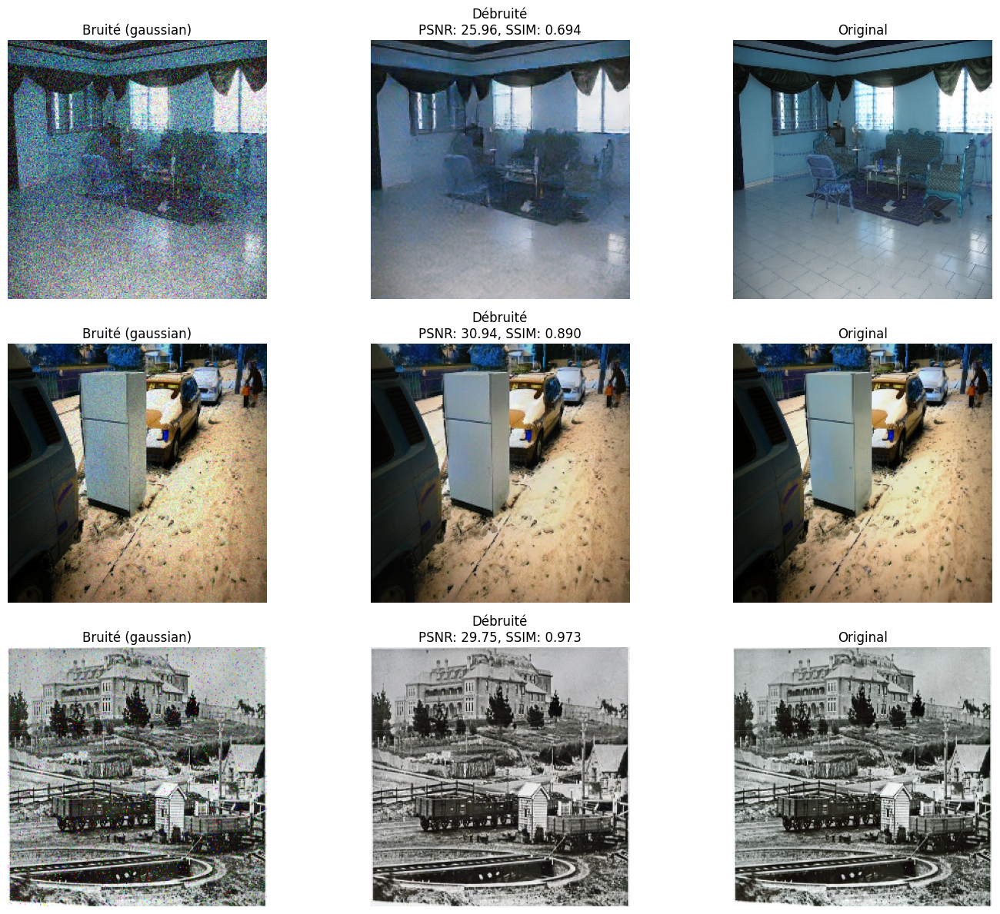

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


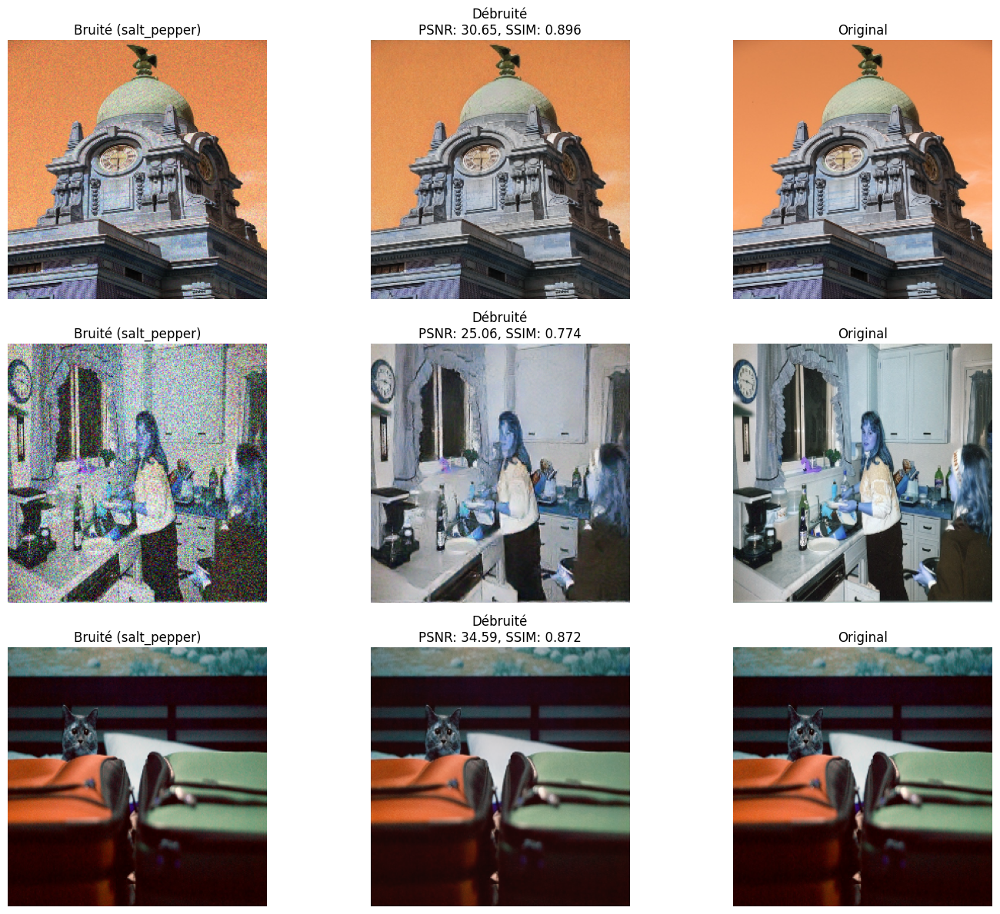

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


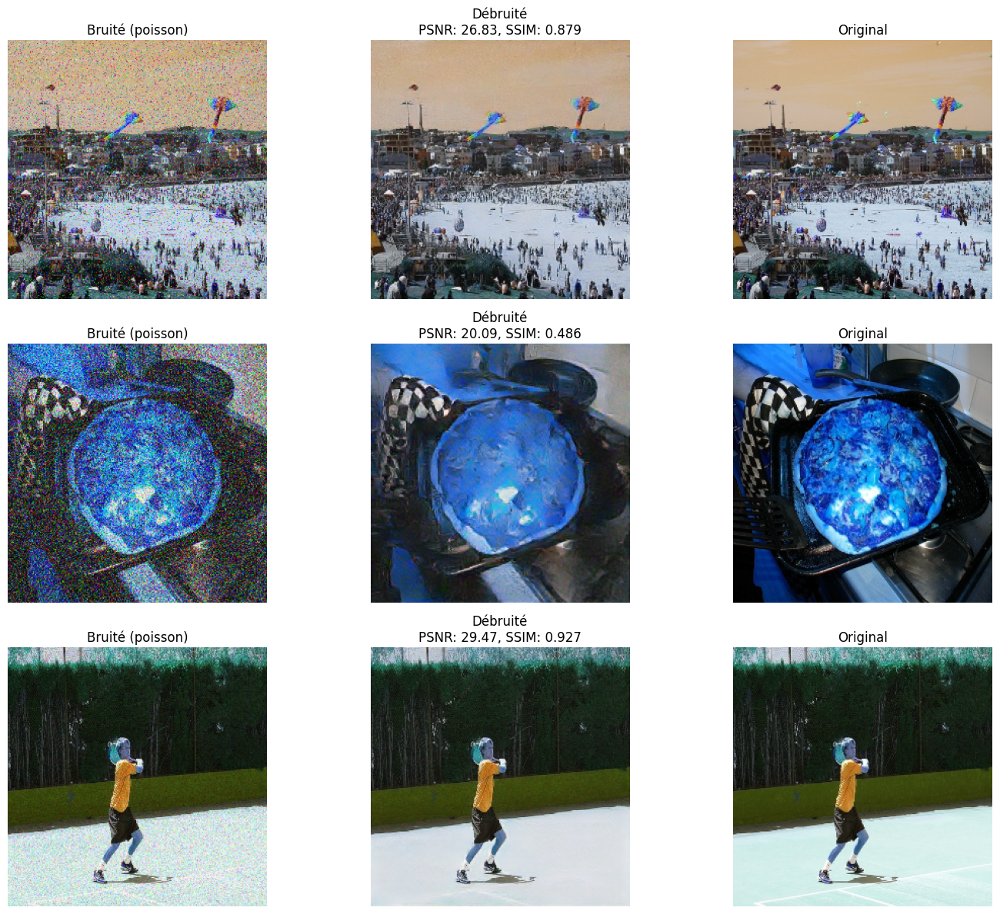

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


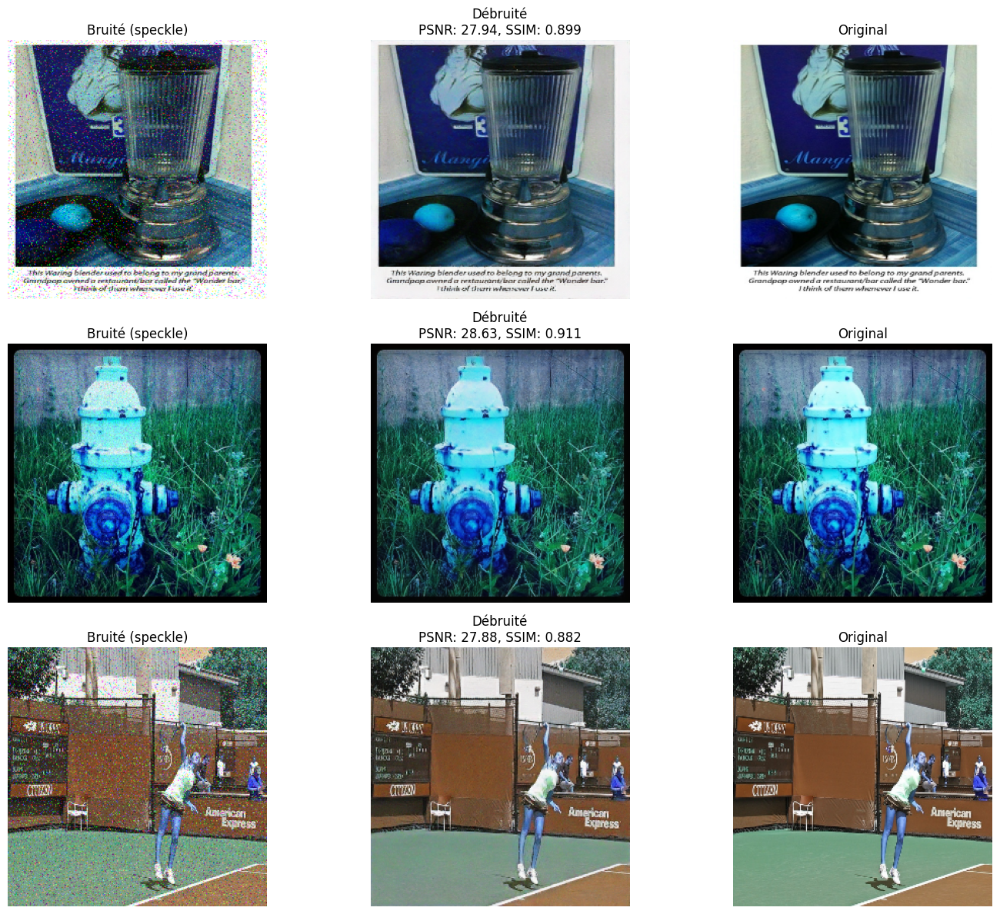

In [ ]:
def plot_noise_comparison(noise_type='gaussian', n_samples=3):
    # Sélection d'images avec le type de bruit spécifié
    idx = [i for i, info in enumerate(noise_info) if info[0] == noise_type]
    if len(idx) == 0:
        print(f"Aucune image trouvée pour le bruit '{noise_type}'")
        return
    n_samples = min(n_samples, len(idx))
    samples = np.random.choice(idx, size=n_samples, replace=False)
    
    plt.figure(figsize=(15, 4 * n_samples))
    for i, sample_idx in enumerate(samples):
        # Récupération des données
        noisy = X_noisy[sample_idx].astype(np.float32)
        clean = X_clean[sample_idx].astype(np.float32)
        

        pred = model.predict(noisy[np.newaxis, ...])[0].astype(np.float32)
        
        # Calcul des métriques (forcer float32)
        psnr_val = tf.image.psnr(clean, pred, max_val=1.0).numpy()
        ssim_val = tf.image.ssim(clean, pred, max_val=1.0).numpy()
        
        # Affichage
        plt.subplot(n_samples, 3, i*3+1)
        plt.imshow(np.clip(noisy, 0, 1))
        plt.title(f"Bruité ({noise_type})")
        plt.axis('off')
        
        plt.subplot(n_samples, 3, i*3+2)
        plt.imshow(np.clip(pred, 0, 1))
        plt.title(f"Débruité\nPSNR: {psnr_val:.2f}, SSIM: {ssim_val:.3f}")
        plt.axis('off')
        
        plt.subplot(n_samples, 3, i*3+3)
        plt.imshow(np.clip(clean, 0, 1))
        plt.title("Original")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Génération des visualisations pour chaque type de bruit
for noise_type in NOISE_CONFIG.keys():
    plot_noise_comparison(noise_type=noise_type)

In [ ]:

def add_noise(img, noise_type, noise_level):
    img = img.astype(np.float32)
    if noise_type == 'gaussian':
        mean = 0
        std = noise_level
        noise = np.random.normal(mean, std, img.shape)
        noisy = img + noise
        return np.clip(noisy, 0, 1)
    elif noise_type == 'salt_pepper':
        s_vs_p = 0.5
        amount = noise_level
        noisy = np.copy(img)
        # Salt
        num_salt = np.ceil(amount * img.size * s_vs_p)
        coords = [np.random.randint(0, i, int(num_salt)) for i in img.shape]
        noisy[tuple(coords)] = 1
        # Pepper
        num_pepper = np.ceil(amount * img.size * (1. - s_vs_p))
        coords = [np.random.randint(0, i, int(num_pepper)) for i in img.shape]
        noisy[tuple(coords)] = 0
        return noisy
    elif noise_type == 'poisson':
        vals = len(np.unique(img))
        vals = 2 ** np.ceil(np.log2(vals))
        noisy = np.random.poisson(img * vals) / float(vals)
        return np.clip(noisy, 0, 1)
    elif noise_type == 'speckle':
        noise = np.random.randn(*img.shape) * noise_level
        noisy = img + img * noise
        return np.clip(noisy, 0, 1)
    else:
        return img

def test_model_on_deposit(model, deposit_dir="notebooks/livrable2/tests_deposit", n_variants=3):
    if not os.path.exists(deposit_dir):
        os.mkdir(deposit_dir)
        return

    image_paths = glob.glob(os.path.join(deposit_dir, "*"))
    if not image_paths:
        print("Aucune image trouvée dans", deposit_dir)
        return

    for img_path in image_paths:
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        if img is None:
            print(f"Impossible de lire {img_path}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, IMG_SIZE) / 255.0
        img = img.astype(np.float32)
        for noise_type, config in NOISE_CONFIG.items():
            # 2 colonnes (noisy, denoised), n_variants lignes
            fig, axes = plt.subplots(n_variants, 2, figsize=(6, 2.5 * n_variants))
            if n_variants == 1:
                axes = np.expand_dims(axes, axis=0)
            for v in range(n_variants):
                # Choix du niveau de bruit
                if 'mean' in config and 'std' in config:
                    level = np.clip(np.random.normal(config['mean'], config['std']), *config['clip'])
                elif noise_type == 'poisson':
                    level = None
                else:
                    level = 0.1
                noisy = add_noise(img, noise_type, level if level is not None else 0.1)
                pred = model.predict(noisy[np.newaxis, ...])[0].astype(np.float32)
                psnr_val = tf.image.psnr(img, pred, max_val=1.0).numpy()
                ssim_val = tf.image.ssim(img, pred, max_val=1.0).numpy()
                # Noisy
                axes[v, 0].imshow(np.clip(noisy, 0, 1))
                axes[v, 0].set_title(f"Noisy\n{noise_type} Var {v+1}")
                axes[v, 0].axis('off')
                # Denoised
                axes[v, 1].imshow(np.clip(pred, 0, 1))
                axes[v, 1].set_title(f"Denoised\nPSNR:{psnr_val:.2f} SSIM:{ssim_val:.3f}")
                axes[v, 1].axis('off')
            plt.suptitle(f"{os.path.basename(img_path)} - {noise_type}", fontsize=14, y=1.02)
            plt.tight_layout()
            plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


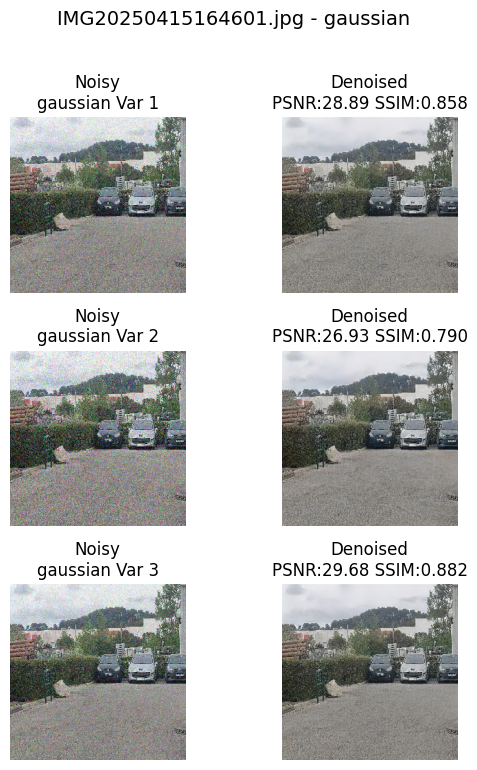

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


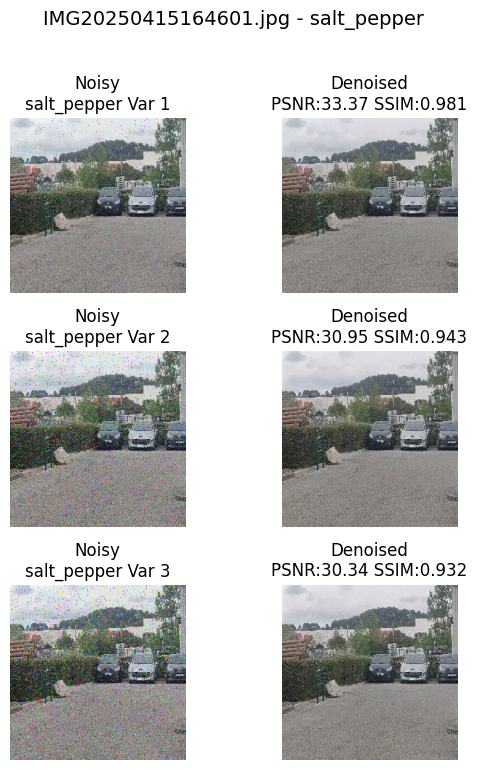

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


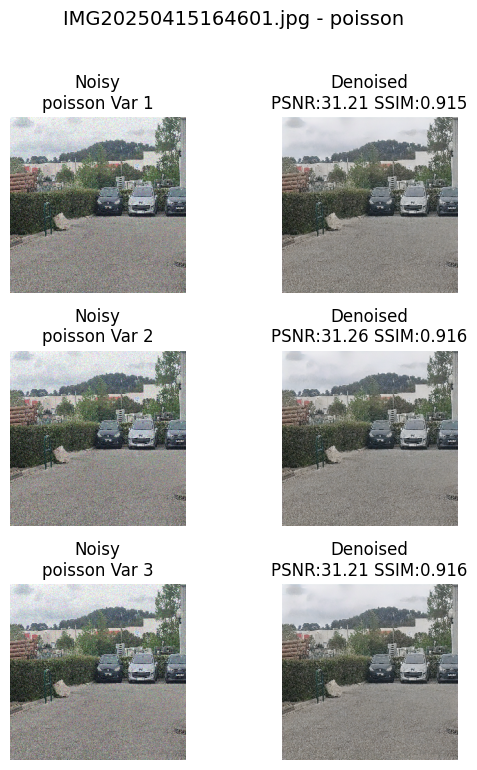

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


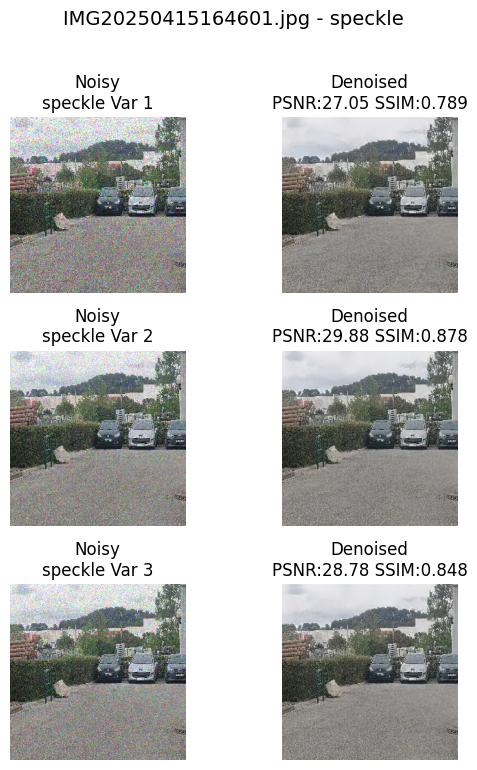

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


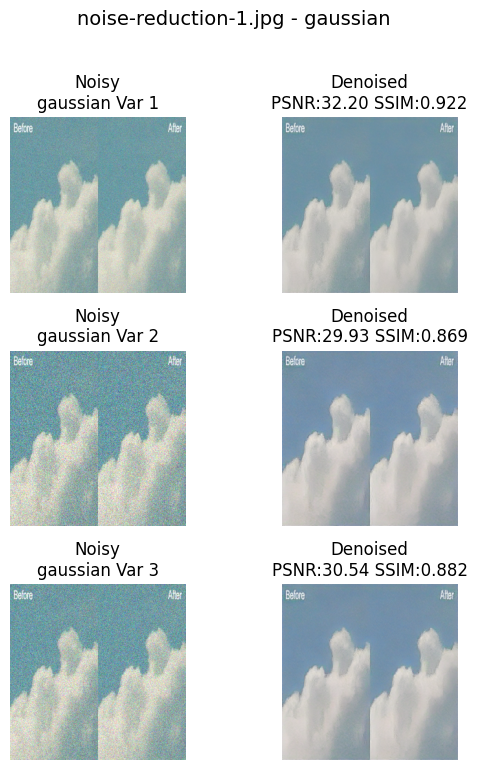

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


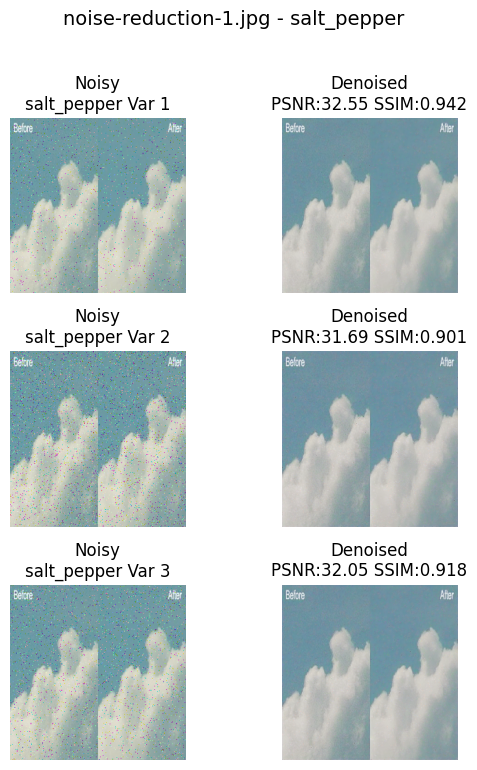

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


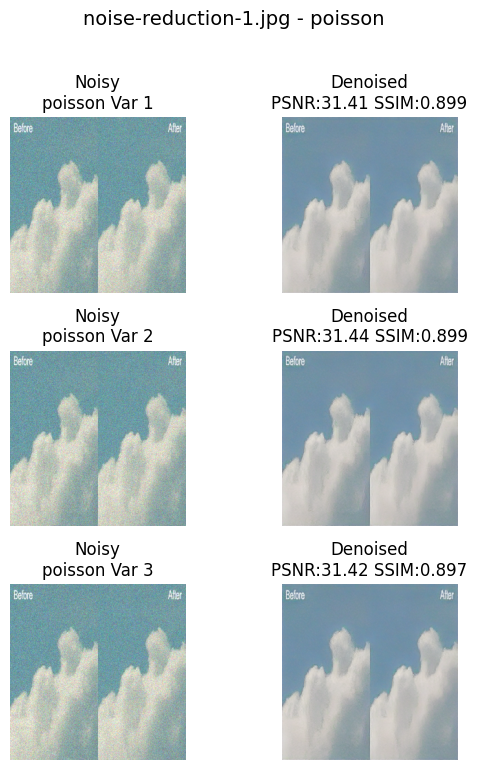

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


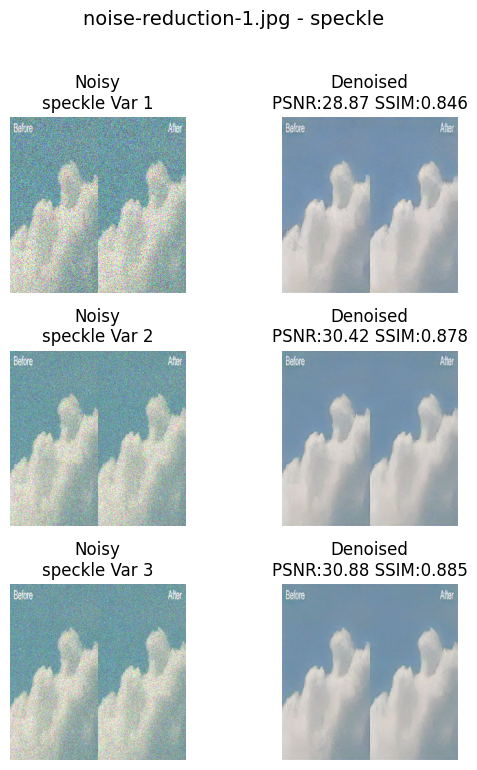

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


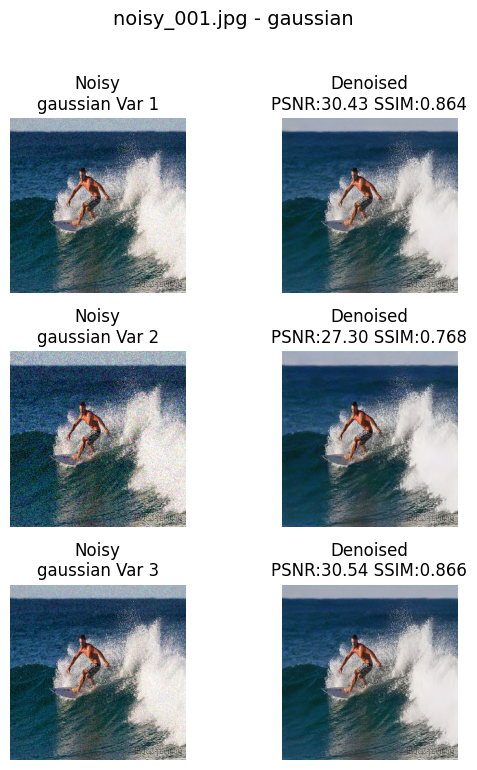

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


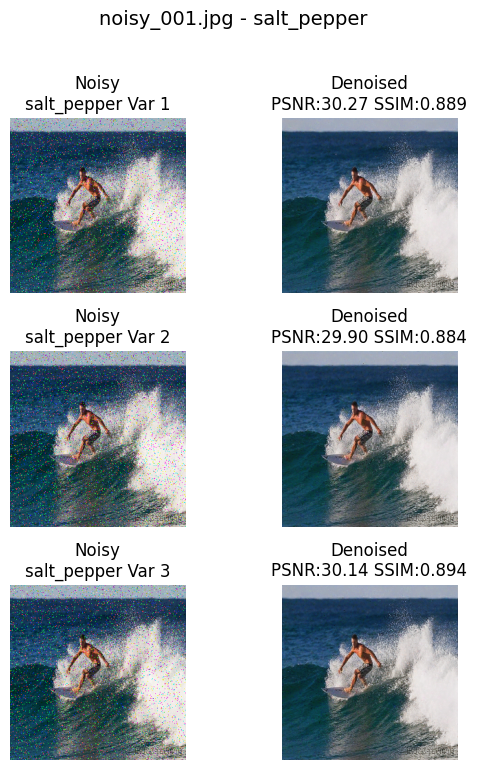

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


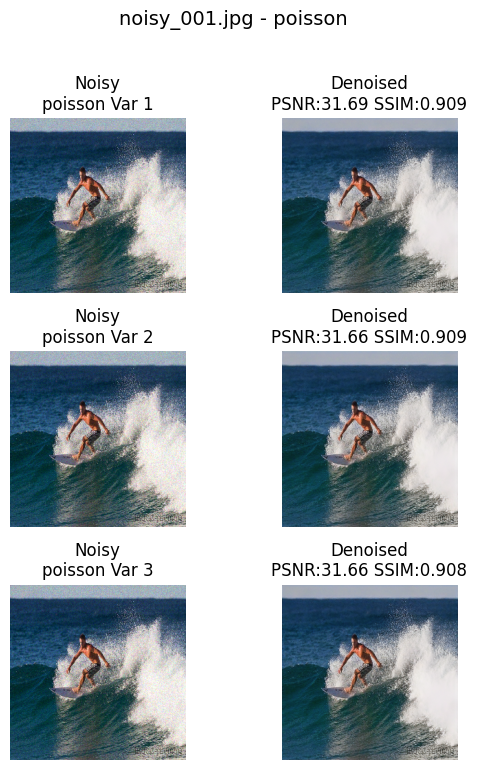

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


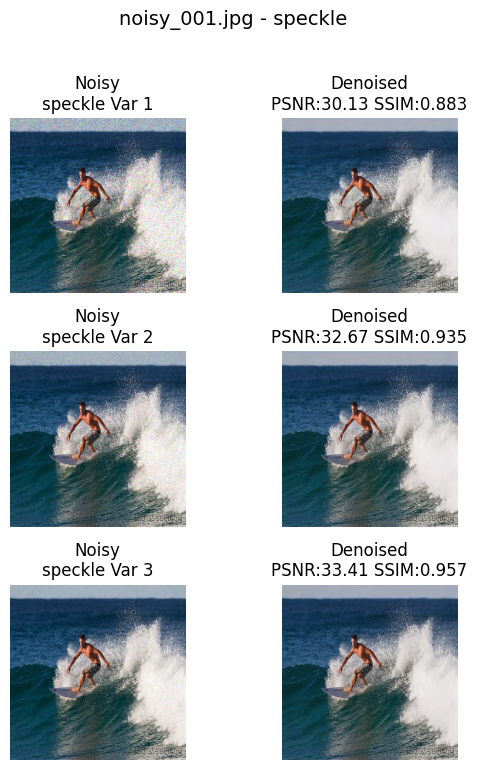

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


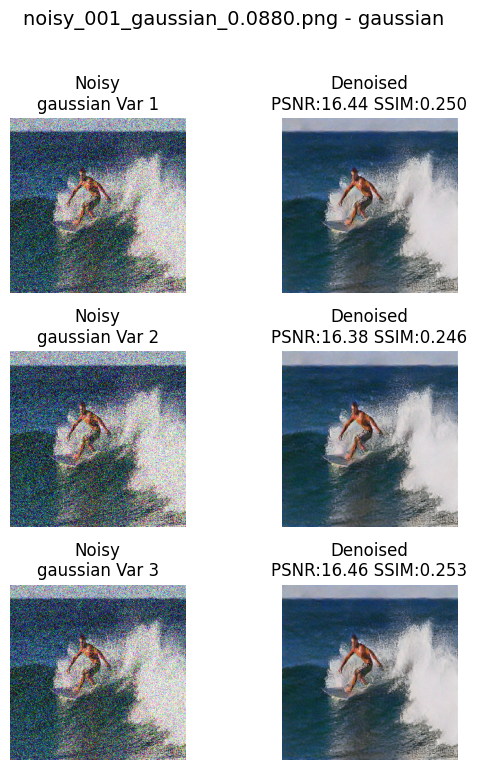

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


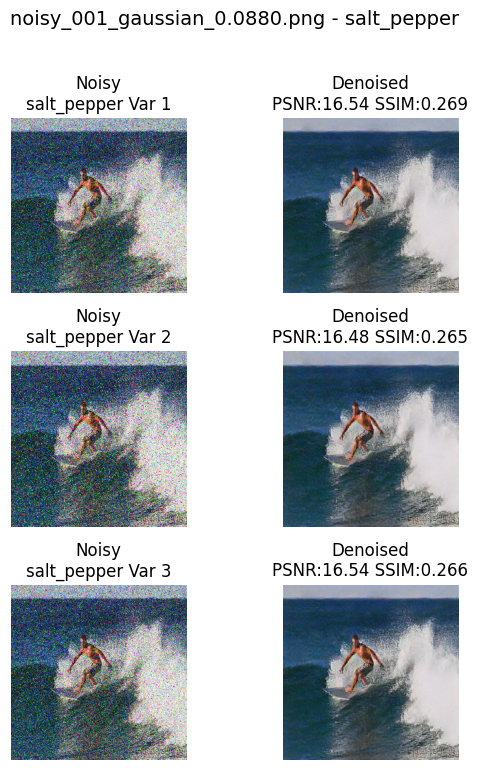

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


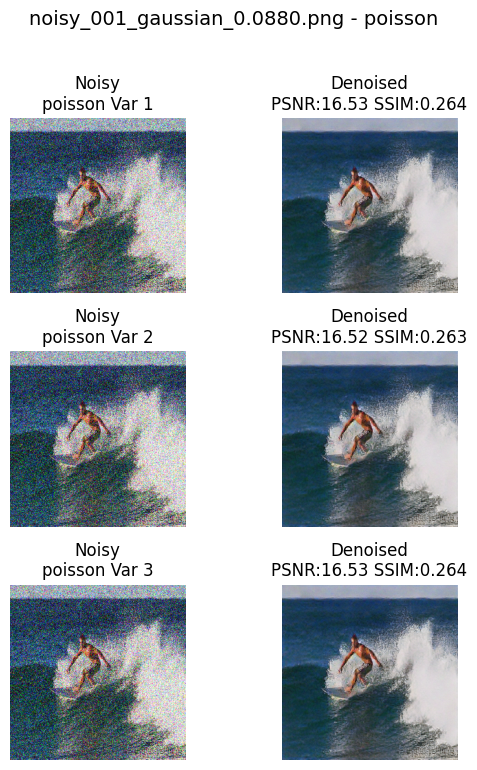

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


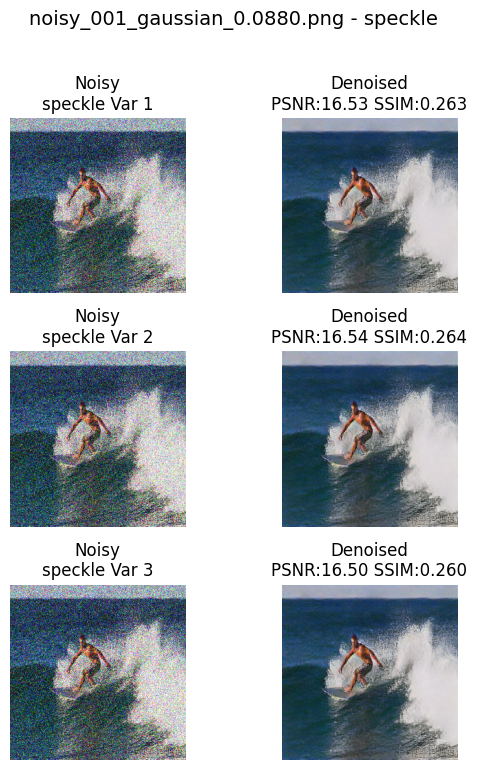

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


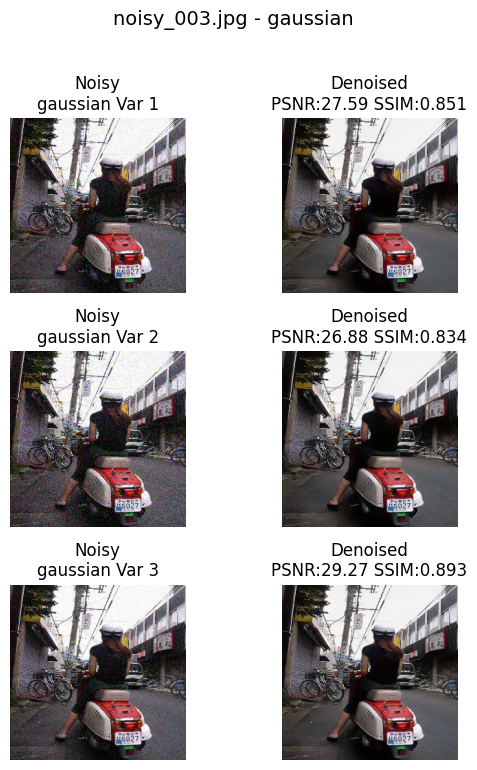

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


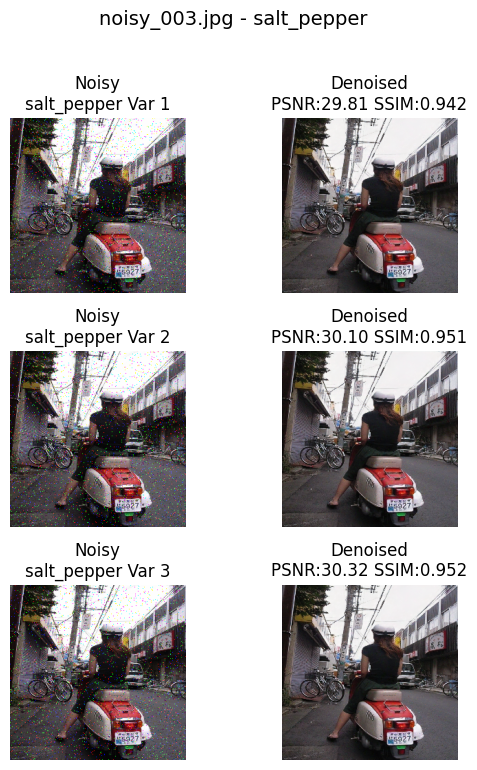

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


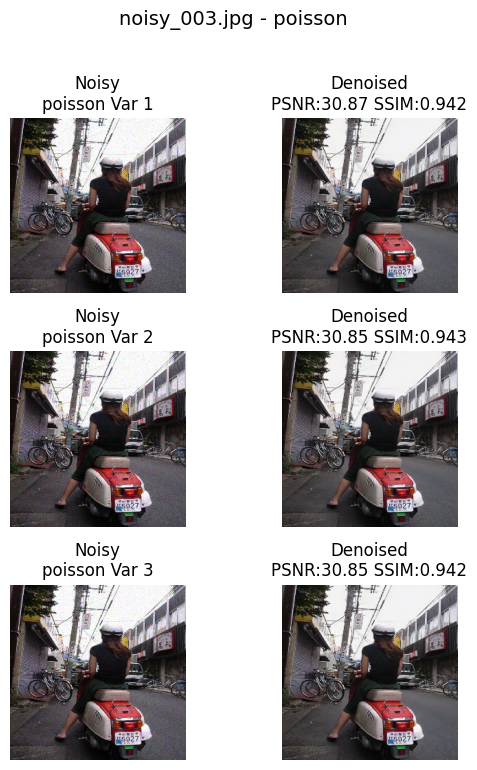

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


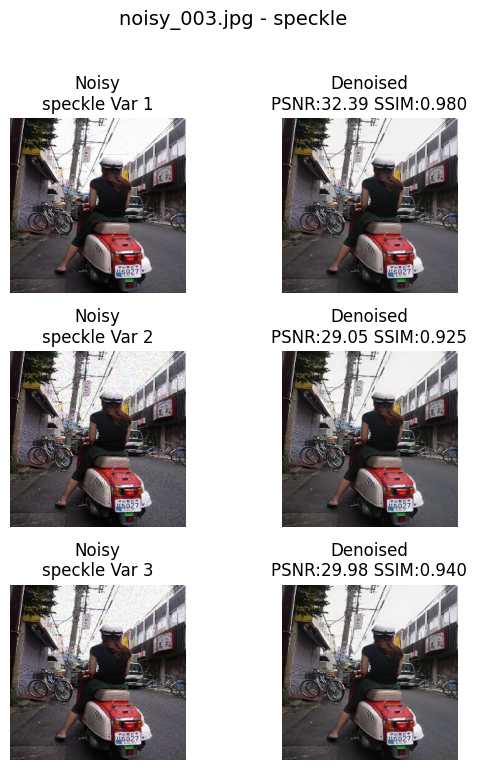

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


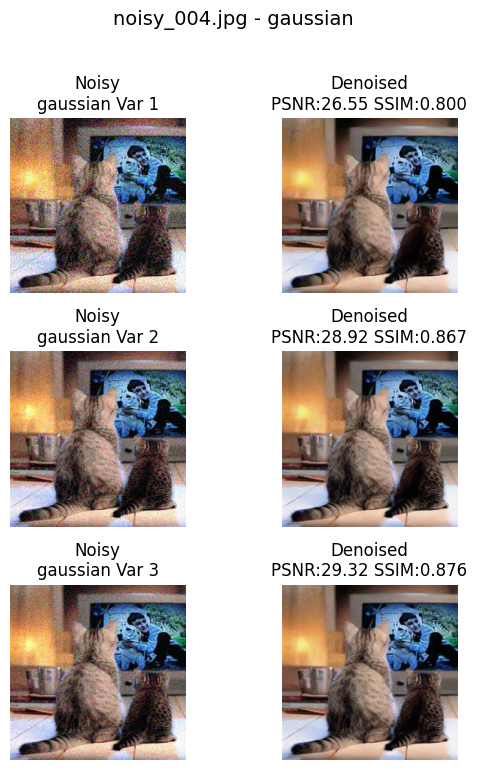

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


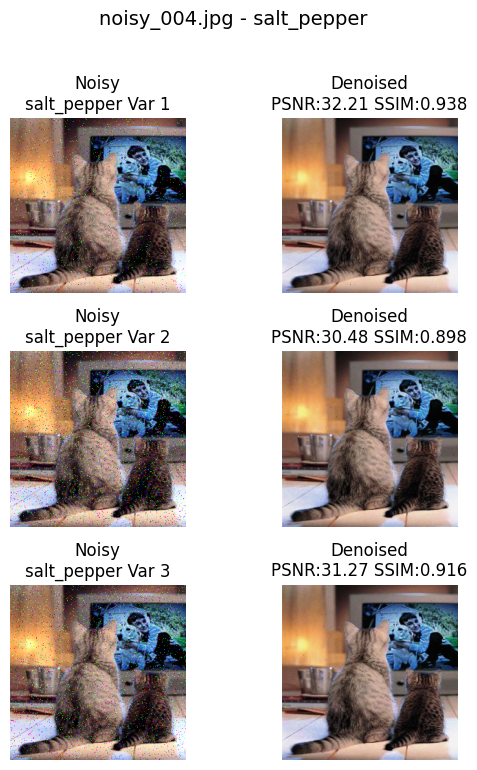

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


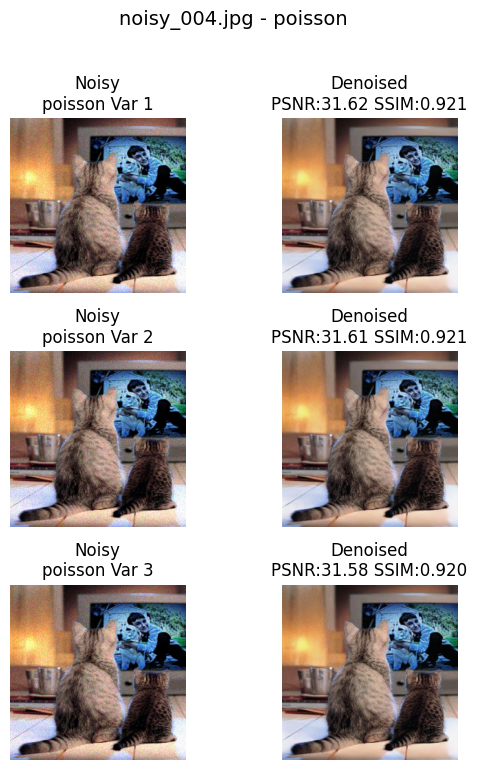

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


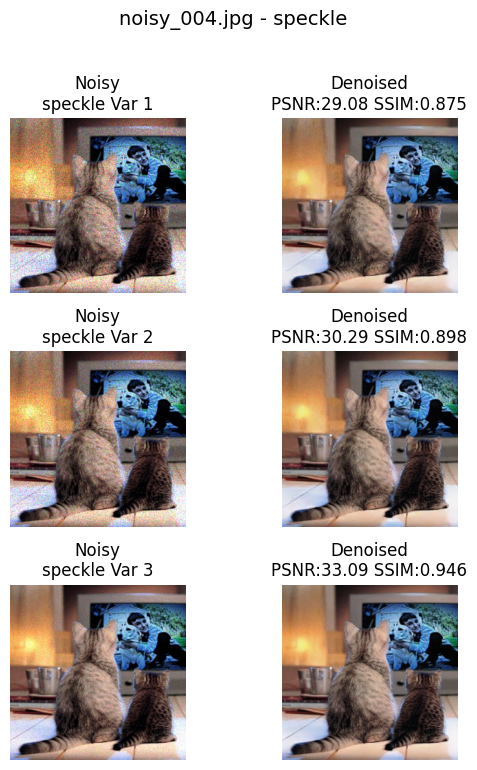

Impossible de lire notebooks/livrable2/tests_deposit/tests_processed


In [ ]:
test_model_on_deposit(model, n_variants=3)

In [ ]:
import glob

def denoise_images_in_folder(model, deposit_dir="notebooks/livrable2/tests_deposit"):
    image_paths = glob.glob(os.path.join(deposit_dir, "*"))
    if not image_paths:
        print("Aucune image trouvée dans", deposit_dir)
        return

    for img_path in image_paths:
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        if img is None:
            print(f"Impossible de lire {img_path}")
            continue
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_resized = cv2.resize(img_rgb, IMG_SIZE) / 255.0
        img_resized = img_resized.astype(np.float32)
        pred = model.predict(img_resized[np.newaxis, ...])[0].astype(np.float32)
        # Affichage côte à côte
        fig, axes = plt.subplots(1, 2, figsize=(8, 4))
        axes[0].imshow(np.clip(img_resized, 0, 1))
        axes[0].set_title("Original")
        axes[0].axis('off')
        axes[1].imshow(np.clip(pred, 0, 1))
        axes[1].set_title("Denoised")
        axes[1].axis('off')

        # Affichage des métriques intéressantes
        psnr_val = tf.image.psnr(img_resized, pred, max_val=1.0).numpy()
        ssim_val = tf.image.ssim(img_resized, pred, max_val=1.0).numpy()
        axes[1].set_title(f"Denoised\nPSNR: {psnr_val:.2f}, SSIM: {ssim_val:.3f}")
        axes[1].axis('off')
        plt.suptitle(os.path.basename(img_path), fontsize=14, y=1.02)
        plt.tight_layout()
        plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


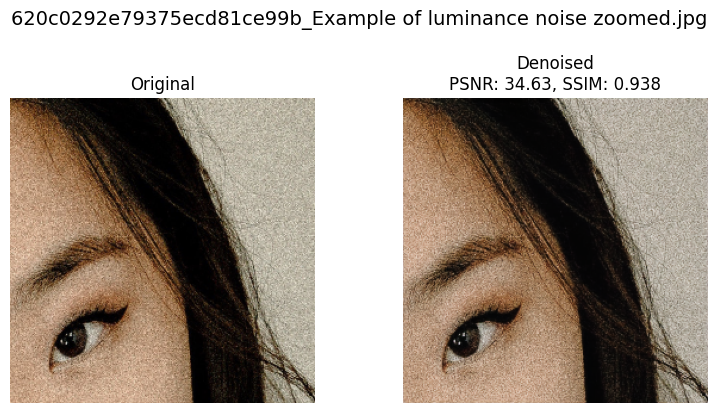

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


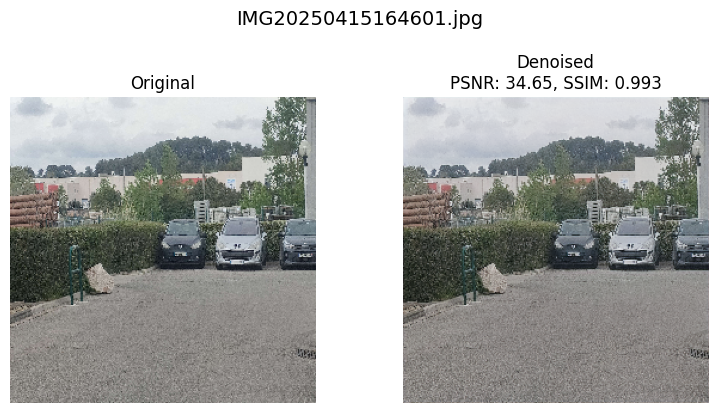

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


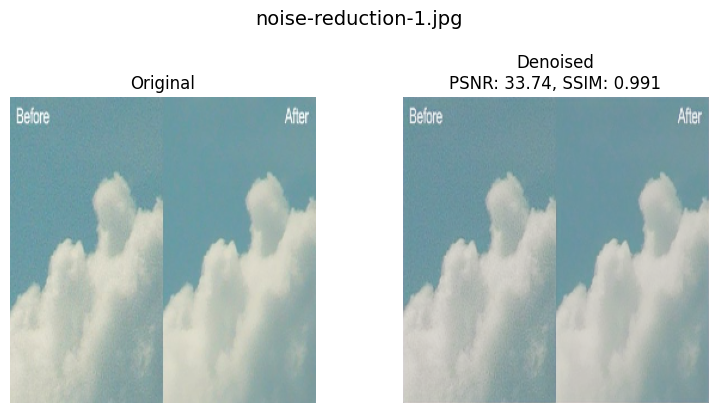

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


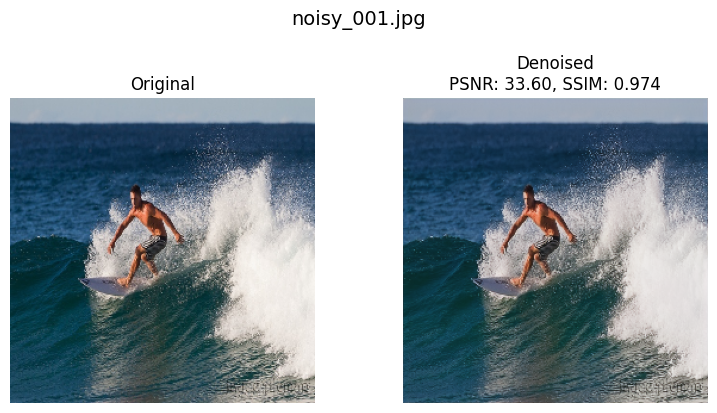

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


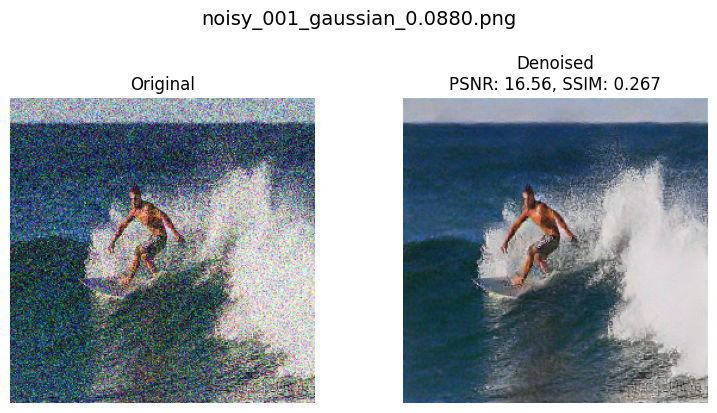

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


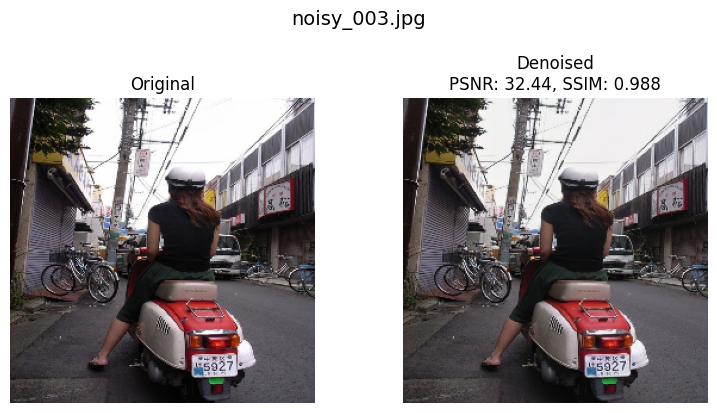

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


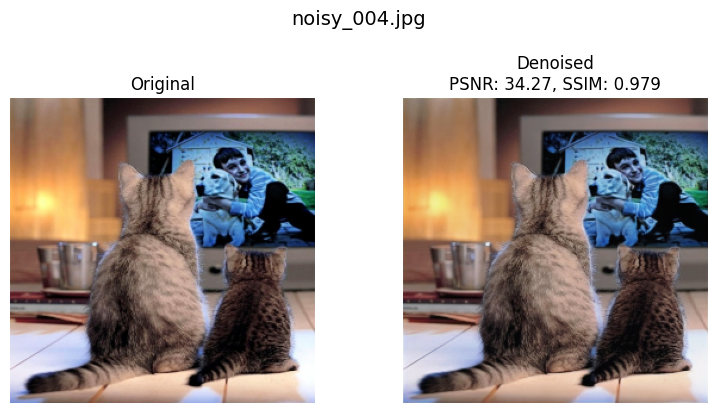

Impossible de lire notebooks/livrable2/tests_deposit/tests_processed


In [ ]:

denoise_images_in_folder(model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


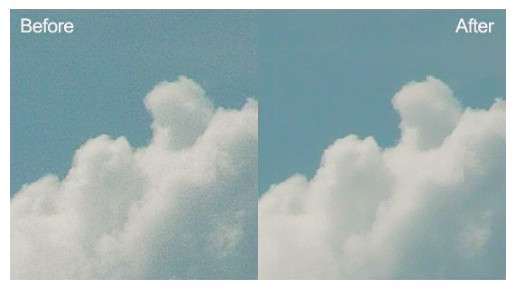

Image enregistrée à : notebooks/livrable2/tests_deposit/tests_processed/processed_image.jpg


In [ ]:
import math

def process_image_by_patches(model, image, patch_size=(256, 256), overlap=32):
    """
    Traite une image de toute taille en la divisant en patchs, puis reconstruit l'image complète.
    
    Args:
        model: modèle de débruitage (ou autre) prenant des images de taille patch_size.
        image: np.ndarray, image d'entrée (H, W, C) en float32, valeurs [0,1].
        patch_size: tuple (h, w), taille des patchs à traiter.
        overlap: int, nombre de pixels de chevauchement entre patchs.
        
    Returns:
        np.ndarray: image reconstruite de la même taille que l'entrée.
    """
    h, w, c = image.shape
    ph, pw = patch_size

    # Calcul du nombre de patchs nécessaires
    n_patches_h = math.ceil((h - overlap) / (ph - overlap))
    n_patches_w = math.ceil((w - overlap) / (pw - overlap))

    # Initialisation de la sortie et du masque de normalisation
    output = np.zeros((h, w, c), dtype=np.float32)
    norm_mask = np.zeros((h, w, c), dtype=np.float32)

    for i in range(n_patches_h):
        for j in range(n_patches_w):
            y1 = i * (ph - overlap)
            x1 = j * (pw - overlap)
            y2 = min(y1 + ph, h)
            x2 = min(x1 + pw, w)
            y1 = max(0, y2 - ph)
            x1 = max(0, x2 - pw)

            patch = image[y1:y2, x1:x2, :]
            # Si le patch n'est pas de la bonne taille, on le complète par du padding
            pad_h = ph - patch.shape[0]
            pad_w = pw - patch.shape[1]
            if pad_h > 0 or pad_w > 0:
                patch = np.pad(patch, ((0, pad_h), (0, pad_w), (0, 0)), mode='reflect')

            # Prédiction sur le patch
            pred_patch = model.predict(patch[np.newaxis, ...])[0]
            # On enlève le padding si besoin
            pred_patch = pred_patch[:patch.shape[0], :patch.shape[1], :]

            # Ajout du patch à la sortie
            output[y1:y2, x1:x2, :] += pred_patch
            norm_mask[y1:y2, x1:x2, :] += 1.0

    # Normalisation pour gérer les zones de chevauchement
    output = output / np.maximum(norm_mask, 1e-8)
    output = np.clip(output, 0, 1)
    return output

img = cv2.imread("notebooks/livrable2/tests_deposit/noise-reduction-1.jpg", cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) / 255.0
result = process_image_by_patches(model, img, patch_size=(256,256), overlap=32)
plt.imshow(result)
plt.axis('off')
plt.show()

## Create a destination folder and save the output image
output_dir = "notebooks/livrable2/tests_deposit/tests_processed"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
output_path = os.path.join(output_dir, "processed_image.jpg")
result = cv2.cvtColor(result, cv2.COLOR_RGB2BGR)  # Convertir en BGR pour OpenCV
cv2.imwrite(output_path, (result * 255).astype(np.uint8))
print(f"Image enregistrée à : {output_path}")

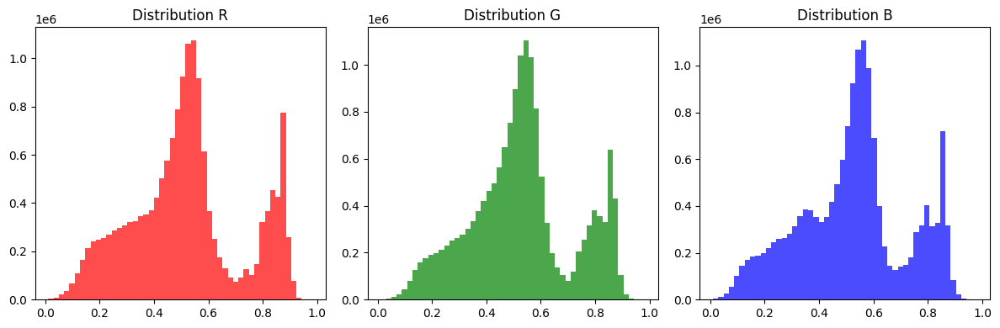

Min/max par canal : [0.01119671 0.01112083 0.01015641] [0.982194   0.9821016  0.98020214]
Moyenne par canal : [0.5025917  0.5127729  0.49684095]


In [ ]:
plt.figure(figsize=(12,4))
for i, color in enumerate(['R', 'G', 'B']):
    plt.subplot(1,3,i+1)
    plt.hist(result[...,i].flatten(), bins=50, color=color.lower(), alpha=0.7)
    plt.title(f'Distribution {color}')
plt.tight_layout()
plt.show()

# Vérification des stats
print("Min/max par canal :", result.min(axis=(0,1)), result.max(axis=(0,1)))
print("Moyenne par canal :", result.mean(axis=(0,1)))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


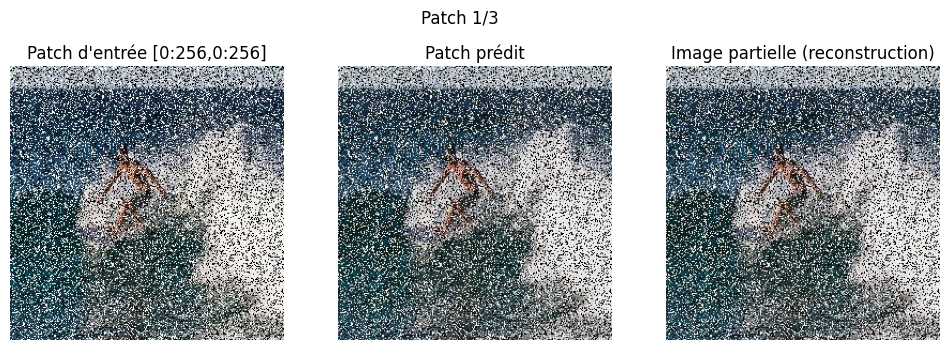

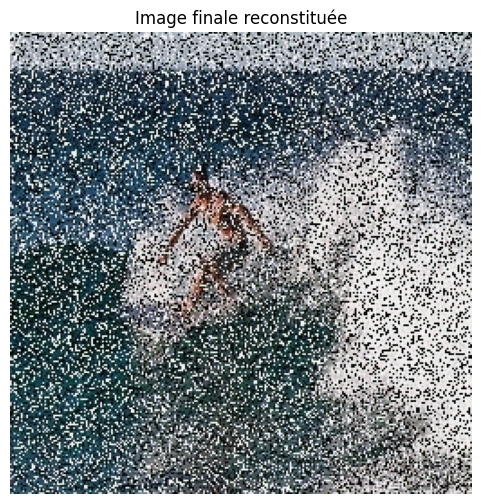

In [ ]:
import math

def debug_process_image_by_patches(model, image, patch_size=(256, 256), overlap=32, force_rgb=True, debug_steps=True, max_patches=3):
    """
    Version debug : affiche les étapes du traitement par patchs.
    """
    image = image.astype(np.float32)
    if image.max() > 1.1:
        image = image / 255.0
    if force_rgb:
        if image.shape[-1] == 1:
            image = np.repeat(image, 3, axis=-1)
        elif image.shape[-1] == 4:
            image = image[..., :3]
    h, w, c = image.shape
    ph, pw = patch_size

    n_patches_h = math.ceil((h - overlap) / (ph - overlap))
    n_patches_w = math.ceil((w - overlap) / (pw - overlap))

    output = np.zeros((h, w, c), dtype=np.float32)
    norm_mask = np.zeros((h, w), dtype=np.float32)  # 2D mask

    patch_count = 0
    for i in range(n_patches_h):
        for j in range(n_patches_w):
            y1 = i * (ph - overlap)
            x1 = j * (pw - overlap)
            y2 = min(y1 + ph, h)
            x2 = min(x1 + pw, w)
            y1 = max(0, y2 - ph)
            x1 = max(0, x2 - pw)

            patch = image[y1:y2, x1:x2, :]
            pad_h = ph - patch.shape[0]
            pad_w = pw - patch.shape[1]
            if pad_h > 0 or pad_w > 0:
                patch = np.pad(patch, ((0, pad_h), (0, pad_w), (0, 0)), mode='reflect')

            pred_patch = model.predict(patch[np.newaxis, ...])[0].astype(np.float32)
            pred_patch = pred_patch[:patch.shape[0], :patch.shape[1], :]

            if pred_patch.shape[-1] == 1:
                pred_patch = np.repeat(pred_patch, 3, axis=-1)
            elif pred_patch.shape[-1] == 4:
                pred_patch = pred_patch[..., :3]

            output[y1:y2, x1:x2, :] += pred_patch
            norm_mask[y1:y2, x1:x2] += 1.0  # 2D mask

            # DEBUG : Affichage des patchs et de la reconstruction partielle
            if debug_steps and patch_count < max_patches:
                fig, axes = plt.subplots(1, 3, figsize=(12, 4))
                axes[0].imshow(np.clip(patch, 0, 1))
                axes[0].set_title(f"Patch d'entrée [{y1}:{y2},{x1}:{x2}]")
                axes[0].axis('off')
                axes[1].imshow(np.clip(pred_patch, 0, 1))
                axes[1].set_title("Patch prédit")
                axes[1].axis('off')
                # Affichage de la zone de sortie en cours de remplissage
                temp_out = output.copy()
                temp_out = temp_out / np.clip(norm_mask[..., None], 1e-6, None)
                axes[2].imshow(np.clip(temp_out, 0, 1))
                axes[2].set_title("Image partielle (reconstruction)")
                axes[2].axis('off')
                plt.suptitle(f"Patch {patch_count+1}/{max_patches}")
                plt.show()
                patch_count += 1

    norm_mask = np.clip(norm_mask, 1e-6, None)
    output = output / norm_mask[..., None]  # broadcast 2D mask to 3D
    output = np.clip(output, 0, 1)

    # DEBUG : Affichage de l'image finale
    plt.figure(figsize=(6, 6))
    plt.imshow(output)
    plt.title("Image finale reconstituée")
    plt.axis('off')
    plt.show()

    return output

# Test debug sur une image
img = cv2.imread("notebooks/livrable2/tests_deposit/image.png", cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) / 255.0
result = debug_process_image_by_patches(model, img, patch_size=(256,256), overlap=32, debug_steps=True, max_patches=3)